In [ ]:
# District with the highest crime count

# Area with the highest crime count

# Crime count for each reporting area in each district

# Crime count for each street in each reporting area of each district

# Crime count by area

# Crime count by district

# Top 20 districts with the highest number of crimes

# Reporting area with the highest crime count

# Top 20 streets with the highest number of crimes

# Streets with the highest crime rate (Top 20)

# Pie chart showing percentage of people who committed crime once vs multiple times

# Crime type that occurs most frequently by time of day

# Crime count by time of day for each crime type

# Crime count by time of day for each day of the week

# Scatter plot of crimes based on latitude and longitude

# Map plot of crimes based on latitude and longitude

# Top 5 crime types committed in:

# Top 5 streets

# Top 5 districts

# Top 5 reporting areas

# Number of crimes committed on each day of every month

# Number of crimes committed in each district for each day of every month

# Number of crimes committed in each district by time of day and day of the week

# Line graph showing crime trends by month for each district (different colored lines)

# Criminals who committed multiple crimes — and which crimes they repeated

# Crimes that occurred together multiple times (e.g., murder + burglary together, etc.)

# Crime count by crime code group

In [ ]:
# date chng format
# -floium ,-ploty,-giopandas,basemap,scatterplot(basic h iska ye ) matplot libs 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df=pd.read_csv("crime_cleaned.csv", encoding="latin1")


In [3]:
df["OCCURRED_ON_DATE"] = pd.to_datetime(
    df["OCCURRED_ON_DATE"],
    format="%Y-%m-%d %H:%M:%S",
    errors="coerce"
)


In [375]:
df

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,DISTRICT,REPORTING_AREA,OCCURRED_ON_DATE,STREET,Lat,Long,NAME
0,I182070945,619,Larceny,D14,808,2018-09-02 13:00:00,LINCOLN ST,42.357791,-71.139371,LARCENY OTHER $200 & OVER
1,I182070885,619,Larceny,B3,456,2018-09-03 17:17:00,ELLINGTON ST,42.301546,-71.081182,LARCENY OTHER $200 & OVER
2,I182070816,619,Larceny,C6,185,2018-09-03 12:45:00,MASSACHUSETTS AVE,42.321987,-71.062807,LARCENY OTHER $200 & OVER
3,I182070777,619,Larceny,C11,388,2018-08-23 13:34:00,ADAMS ST,42.272306,-71.067214,LARCENY OTHER $200 & OVER
4,I182070707,619,Larceny,D14,782,2018-09-02 23:12:00,GORDON ST,42.352935,-71.140501,LARCENY OTHER $200 & OVER
...,...,...,...,...,...,...,...,...,...,...
310339,I110551302-00,623,Larceny,D4,171,2015-07-22 22:00:00,HARRISON AVE,42.335560,-71.074364,LARCENY SHOPLIFTING $50 TO $199
310340,I130041200-00,547,Burglary - No Property Taken,B3,428,2015-12-07 11:38:00,DIXWELL ST,42.314334,-71.097914,B&E NON-RESIDENCE DAY - NO PROP TAKEN
310341,I120720047-00,334,Robbery,E13,565,2015-07-17 09:23:00,SENATOR BOLLING CIR,42.291667,-71.091021,ROBBERY - UNARMED - BUSINESS
310342,I120719309-00,530,Commercial Burglary,A1,119,2015-07-27 12:00:00,BOYLSTON ST,42.352418,-71.065255,B&E NON-RESIDENCE NIGHT - FORCE


In [4]:
# hr dist ka highest crime 
DCC = (
    df.groupby(["DISTRICT","OFFENSE_CODE_GROUP"])
      .size()
      .reset_index(name="Crime_Count")
)

District_higest_crime = (
    DCC
    .loc[DCC.groupby("DISTRICT")["Crime_Count"].idxmax()]
    .reset_index(drop=True)
)



# hr reporting_area ka highest crime
Reporting_area_highest_crime=df.groupby("REPORTING_AREA")["OFFENSE_CODE_GROUP"].apply(lambda x: x.mode()[0]).reset_index(name="Highest_crime")

# with district combined
Reporting_area_highest_crime_dist=df.groupby(["DISTRICT","REPORTING_AREA"])["OFFENSE_CODE_GROUP"].apply(lambda x: x.mode()[0]).reset_index(name="Highest_crime")

# hr dist ka  crime k count
District_crime_count=df.groupby("DISTRICT").agg(Crime_count=("INCIDENT_NUMBER","count")).pivot_table(index="DISTRICT"
                                                                                                     ,values="Crime_count")
# hr rep_area ka  crime k count
Reporting_area_crime_count=df.groupby("REPORTING_AREA").agg(Crime_count=("INCIDENT_NUMBER","count"))


# hr crime konse dist mai svhse jda hua h uska count top 20
crime_highest_dist = df.value_counts(["OFFENSE_CODE_GROUP","DISTRICT"]).reset_index(name="Crime_Count").loc[lambda x: x.groupby("OFFENSE_CODE_GROUP")["Crime_Count"].idxmax()]
top20_crimes_dist = crime_highest_dist.sort_values("Crime_Count", ascending=False).head(20).reset_index(drop=True)

# hr crime konse Rep_area mai svhse jda hua h uska count top 20
crime_highest_Rep_area = df.value_counts(["OFFENSE_CODE_GROUP","REPORTING_AREA"]).reset_index(name="Crime_Count").loc[lambda x: x.groupby("OFFENSE_CODE_GROUP")["Crime_Count"].idxmax()]
top20_crimes_Rep = crime_highest_Rep_area.sort_values("Crime_Count", ascending=False).head(20).reset_index(drop=True)

# hr crime konse street mai svhse jda hua h top 20
crime_highest_street = df.value_counts(["OFFENSE_CODE_GROUP","STREET"]).reset_index(name="Crime_Count").loc[lambda x: x.groupby("OFFENSE_CODE_GROUP")["Crime_Count"].idxmax()]
top20_crimes_street = crime_highest_street.sort_values("Crime_Count", ascending=False).head(20).reset_index(drop=True)


# top 5 crime konse top 5 street mai comit hue h
df["OFFENSE_CODE_GROUP"] = df["OFFENSE_CODE_GROUP"].str.strip()
top5_crimes = df["OFFENSE_CODE_GROUP"].value_counts().head(5).index
top5_streets_per_crime = (
    df[df["OFFENSE_CODE_GROUP"].isin(top5_crimes)]
    .value_counts(["OFFENSE_CODE_GROUP","STREET"])
    .reset_index(name="Crime_Count")
    .sort_values(["OFFENSE_CODE_GROUP","Crime_Count"], ascending=[True, False])
    .groupby("OFFENSE_CODE_GROUP")
    .head(5)
    .reset_index(drop=True)
)

# top5_streets_per_crime=top5_streets_per_crime.pivot_table(index="OFFENSE_CODE_GROUP",columns="STREET",values="Crime_Count",fill_value=0)


# top 5 crime konse top 5 rep area mai comit hue h
reparea_crime=pd.pivot_table(
    df[df["OFFENSE_CODE_GROUP"].isin(top5_crimes)],
    index="REPORTING_AREA",columns="OFFENSE_CODE_GROUP",values="INCIDENT_NUMBER",aggfunc="count",fill_value=0
)
long_df = reparea_crime.stack().reset_index(name="Crime_Count")

top5_reparea_per_crime=long_df.sort_values(["OFFENSE_CODE_GROUP","Crime_Count"],ascending=[True,False]).groupby("OFFENSE_CODE_GROUP").head(5).reset_index(drop=True)


# top 5 crime konse top 5 dist mai comit hue h
dist_crime=pd.pivot_table(
    df[df["OFFENSE_CODE_GROUP"].isin(top5_crimes)],
    index="DISTRICT",columns="OFFENSE_CODE_GROUP",values="INCIDENT_NUMBER",aggfunc="count",fill_value=0
)
long_df = dist_crime.stack().reset_index(name="Crime_Count")

top5_dist_per_crime=long_df.sort_values(["OFFENSE_CODE_GROUP","Crime_Count"],ascending=[True,False]).groupby("OFFENSE_CODE_GROUP").head(5).reset_index(drop=True)


# hr dis ke hr rep area ka  crime count
dist_reparea_crime_count=(pd.pivot_table(df,index=["DISTRICT","REPORTING_AREA"],values="INCIDENT_NUMBER",aggfunc="count",fill_value=0).rename(columns={"INCIDENT_NUMBER":"Crime_Count"}))

# hr dis ke hr rep area hr street ka  crime count
dist_reparea_street_crime_count=(pd.pivot_table(df,index=["DISTRICT","REPORTING_AREA","STREET"],values="INCIDENT_NUMBER",aggfunc="count",fill_value=0).rename(columns={"INCIDENT_NUMBER":"Crime_Count"}))


# street with the highest crime rate top 10 
top10street_highest_crime_rate=df.groupby("STREET").agg(Crime_count=("INCIDENT_NUMBER","count"))
top10street_highest_crime_rate=top10street_highest_crime_rate.sort_values("Crime_count",ascending=False).head(10)

# hr offense code grp ke crime count
offense_code_group_crime=df.groupby(["OFFENSE_CODE","OFFENSE_CODE_GROUP"]).agg(Crime_count=("OFFENSE_CODE_GROUP","count"))
offense_code_crime=df.groupby(["OFFENSE_CODE"]).agg(Crime_count=("OFFENSE_CODE_GROUP","count"))

# hr district ke hr month ke hr din mai
dist_month_day_crime = (
    pd.pivot_table(
        df,
        index=[
            "DISTRICT",
            df["OCCURRED_ON_DATE"].dt.month,
            df["OCCURRED_ON_DATE"].dt.day
        ],
        values="INCIDENT_NUMBER",
        aggfunc="count",
        fill_value=0
    )
    .rename_axis(["DISTRICT","Month","Day"])
    .reset_index()
    .rename(columns={"INCIDENT_NUMBER": "Crime_Count"})
)

# hr month ke hr din mai kitne cirme comit hue hw 
month_day_crime = pd.pivot_table(
    df,
    index=df["OCCURRED_ON_DATE"].dt.month,
    columns=df["OCCURRED_ON_DATE"].dt.day,
    values="INCIDENT_NUMBER",
    aggfunc="count",
    fill_value=0
)
month_day_crime.index.name = "Month"
month_day_crime.columns.name = "Day"



# hfte ke hr din pe kis time mai crime kitne comit hue h
week_hour_crime = pd.pivot_table(
    df,
    index=df["OCCURRED_ON_DATE"].dt.day_name(),   # Monday, Tuesday...
    columns=df["OCCURRED_ON_DATE"].dt.hour,      # 0–23 hours
    values="INCIDENT_NUMBER",
    aggfunc="count",
    fill_value=0
)

week_hour_crime.index.name = "Weekday"
week_hour_crime.columns.name = "Hour"


# hr district ke hafte ke hr time mai kitne crime comit hue h
dist_week_hour_crime = pd.pivot_table(
    df,
    index=[
        "DISTRICT",
        df["OCCURRED_ON_DATE"].dt.day_name()
    ],
    columns=df["OCCURRED_ON_DATE"].dt.hour,
    values="INCIDENT_NUMBER",
    aggfunc="count",
    fill_value=0
)

dist_week_hour_crime.index.names = ["DISTRICT", "Weekday"]
dist_week_hour_crime.columns.name = "Hour"


# konsa crime kis time mai kitna occr hua h
crime_occured_time=pd.pivot_table(df,index="OFFENSE_CODE_GROUP",columns=df["OCCURRED_ON_DATE"].dt.hour,values="INCIDENT_NUMBER",
                                       aggfunc="count",fill_value=0)
crime_occured_time.index.name="Crime"
crime_occured_time.columns.name="Hour"

# konsa crime kis time mai svhse jda occr hua h
crime_hour_pivot = pd.pivot_table(
    df,
    index="OFFENSE_CODE_GROUP",
    columns=df["OCCURRED_ON_DATE"].dt.hour,
    values="INCIDENT_NUMBER",
    aggfunc="count",
    fill_value=0
)
peak_hour = crime_hour_pivot.idxmax(axis=1)
peak_count = crime_hour_pivot.max(axis=1)

crime_peak_time = pd.DataFrame({
    "OFFENSE_CODE_GROUP": peak_hour.index,
    "Peak_Hour": peak_hour.values,
    "Crime_Count": peak_count.values
})

# line chart ke liye data for dist-month -crime relation
dist_month_trend = pd.pivot_table(
    df,
    index=df["OCCURRED_ON_DATE"].dt.month,
    columns="DISTRICT",
    values="INCIDENT_NUMBER",
    aggfunc="count",
    fill_value=0
)

dist_month_trend.index.name = "Month"


# pi chart kinte % log ne 1 br kiya h aur kinto ne jda  
incident_freq = df["INCIDENT_NUMBER"].value_counts()
one_time = (incident_freq == 1).sum()
multiple_time = (incident_freq > 1).sum()


repeat_distribution = incident_freq.value_counts().sort_index()



# crime jo ek sth ek se jda br commit hogye ho like muder,bulgary sth mai etc
simultaneous_times = df["OCCURRED_ON_DATE"].value_counts()
simultaneous_times = simultaneous_times[simultaneous_times > 1].index
cluster_crimes = df[df["OCCURRED_ON_DATE"].isin(simultaneous_times)]
from itertools import combinations
from collections import Counter

crime_pairs = []

for _, g in cluster_crimes.groupby("OCCURRED_ON_DATE"):
    crimes = g["OFFENSE_CODE_GROUP"].unique()
    for pair in combinations(sorted(crimes), 2):
        crime_pairs.append(pair)

crime_together_count = (
    pd.Series(crime_pairs)
      .value_counts()
      .reset_index()
)

crime_together_count.columns = ["Crime_Together", "Together_Count"]

# sccatter plot lat,long based ,map plot lat ,long based,
scatter_data = df[
    (df["Lat"].notna()) &
    (df["Long"].notna()) &
    (df["Lat"] != -1) &
    (df["Long"] != -1)
][["Lat","Long","DISTRICT","OFFENSE_CODE_GROUP","OCCURRED_ON_DATE"]]

map_density_data = (
    df[(df["Lat"] != -1) & (df["Long"] != -1)]
    .groupby(["Lat","Long"])
    .size()
    .reset_index(name="Crime_Count")
)



In [377]:
District_higest_crime
Reporting_area_highest_crime
Reporting_area_highest_crime_dist
District_crime_count
Reporting_area_crime_count
crime_highest_dist
top20_crimes_dist
top20_crimes_Rep
top20_crimes_street
top5_streets_per_crime
top5_reparea_per_crime
top5_dist_per_crime
dist_reparea_crime_count
dist_reparea_street_crime_count
top10street_highest_crime_rate
offense_code_crime
dist_month_day_crime
month_day_crime
week_hour_crime
dist_week_hour_crime
crime_occured_time
crime_peak_time
dist_month_trend
crime_together_count
scatter_data
map_density_data

,Lat,Long,Crime_Count
0,42.232413,-71.129715,10
1,42.232656,-71.130700,2
2,42.232870,-71.130050,5
3,42.232907,-71.131671,3
4,42.233086,-71.128157,14
...,...,...,...
17823,42.393518,-71.011405,13
17824,42.393529,-71.011582,77
17825,42.394073,-71.010964,15
17826,42.394213,-71.067413,8


In [378]:
df["OCCURRED_ON_DATE"].dtype


dtype('<M8[ns]')

In [379]:
#                                               PLOTTING

In [380]:
District_higest_crime

,DISTRICT,OFFENSE_CODE_GROUP,Crime_Count
0,A1,Larceny,4680
1,A15,Motor Vehicle Accident Response,950
2,A7,Motor Vehicle Accident Response,1509
3,B2,Motor Vehicle Accident Response,6343
4,B3,Motor Vehicle Accident Response,3832
5,C11,Motor Vehicle Accident Response,5291
6,C6,Motor Vehicle Accident Response,2663
7,D14,Motor Vehicle Accident Response,2849
8,D4,Larceny,7302
9,E13,Motor Vehicle Accident Response,2159


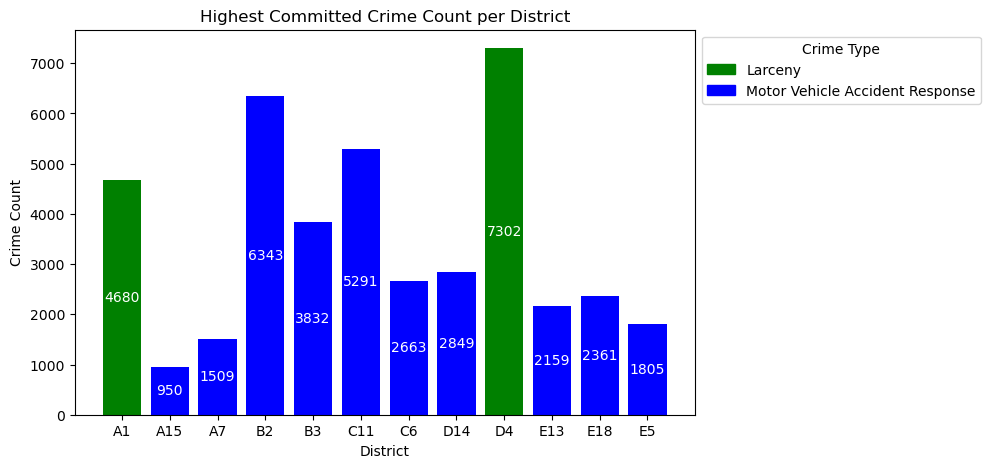

In [381]:
# 1. District_higest_crime
District_higest_crime
plt.figure(figsize=(8,5))
crime_col = District_higest_crime.iloc[:,1]
colors = [
    "green" if crime == "Larceny" else "blue"
    for crime in crime_col
]
b1=plt.bar(
    District_higest_crime["DISTRICT"],
    District_higest_crime["Crime_Count"],
    color=colors
)
plt.bar_label(b1,label_type="center",fmt="%.0f",color="white")
plt.xlabel("District")
plt.ylabel("Crime Count")
plt.title("Highest Committed Crime Count per District")
from matplotlib.patches import Patch
legend_items = [
    Patch(color="green", label="Larceny"),
    Patch(color="blue", label="Motor Vehicle Accident Response")
]

plt.legend(handles=legend_items, title="Crime Type",bbox_to_anchor=(1,1))
plt.show()


In [382]:
Reporting_area_highest_crime

,REPORTING_AREA,Highest_crime
0,1,Drug Violation
1,2,Motor Vehicle Accident Response
2,3,Motor Vehicle Accident Response
3,4,Motor Vehicle Accident Response
4,5,Motor Vehicle Accident Response
...,...,...
872,958,Medical Assistance
873,959,Medical Assistance
874,960,Medical Assistance
875,961,Motor Vehicle Accident Response


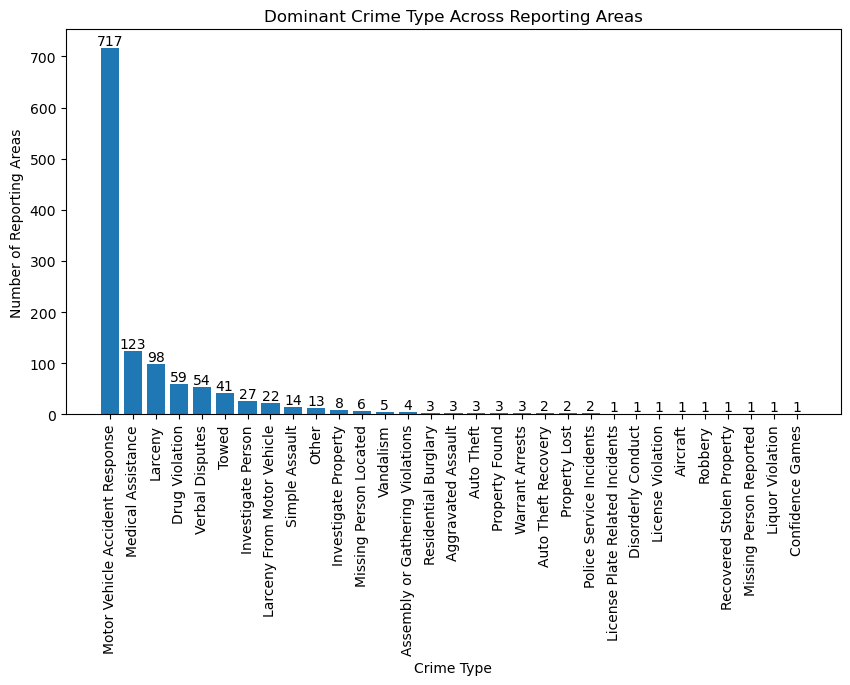

In [383]:
# 2. Reporting_area_highest_crime
crime_area_count = (
    Reporting_area_highest_crime_dist["Highest_crime"]
    .value_counts()
    .reset_index()
)

crime_area_count.columns = ["Crime_Type", "Area_Count"]
plt.figure(figsize=(10,5))

b1 = plt.bar(
    crime_area_count["Crime_Type"],
    crime_area_count["Area_Count"]
)

plt.bar_label(b1, fmt="%.0f")

plt.xlabel("Crime Type")
plt.ylabel("Number of Reporting Areas")
plt.title("Dominant Crime Type Across Reporting Areas")
plt.xticks(rotation=90)
plt.show()


In [384]:
# 3.hr dis ke hr rep area ka  crime count   
dist_reparea_crime_count



Crime_Count
DISTRICT REPORTING_AREA             
A1       41                       32
         58                       19
         61                      945
         62                      112
         63                      652
...                              ...
E5       825                      10
         910                     159
         914                       9
         932                      81
         941                     290

[1221 rows x 1 columns]

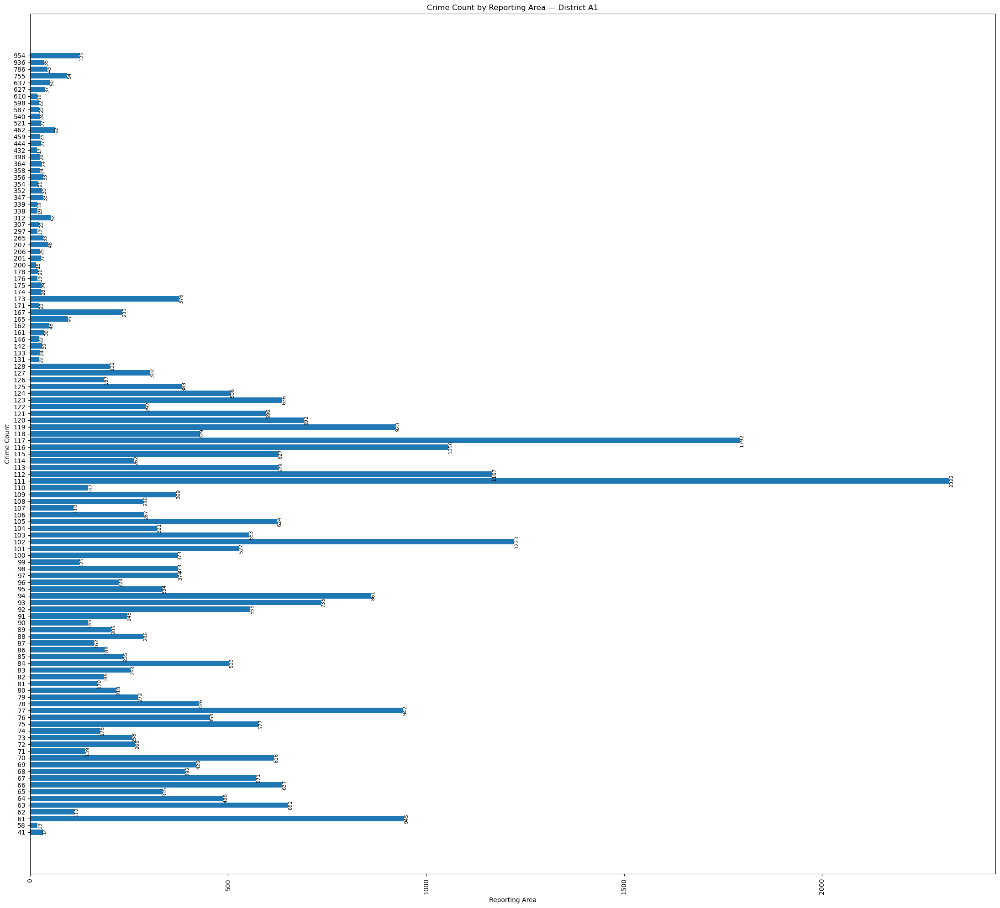

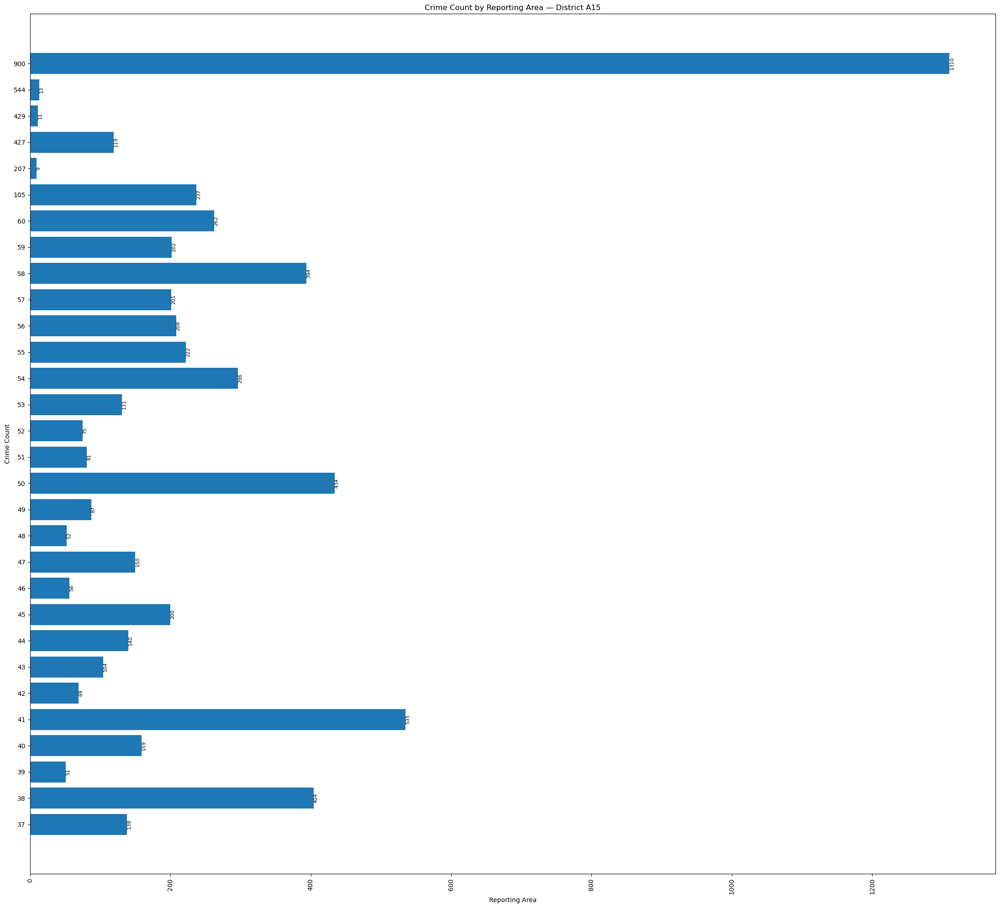

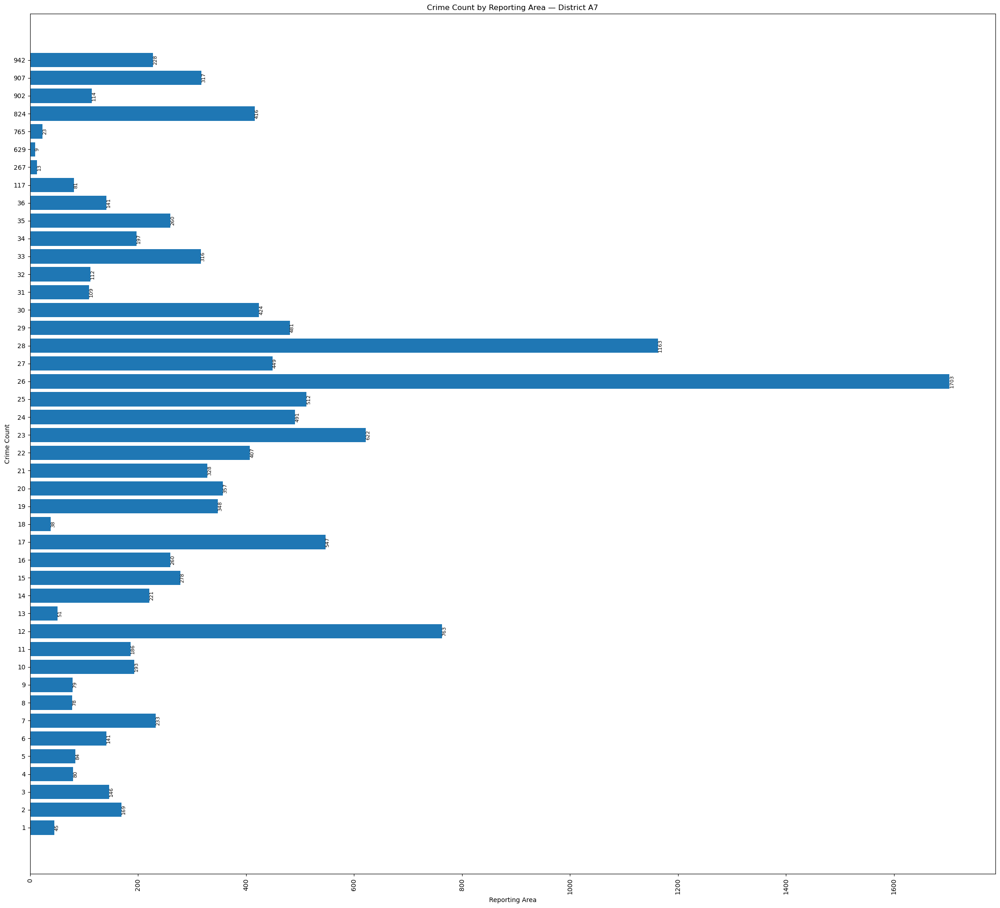

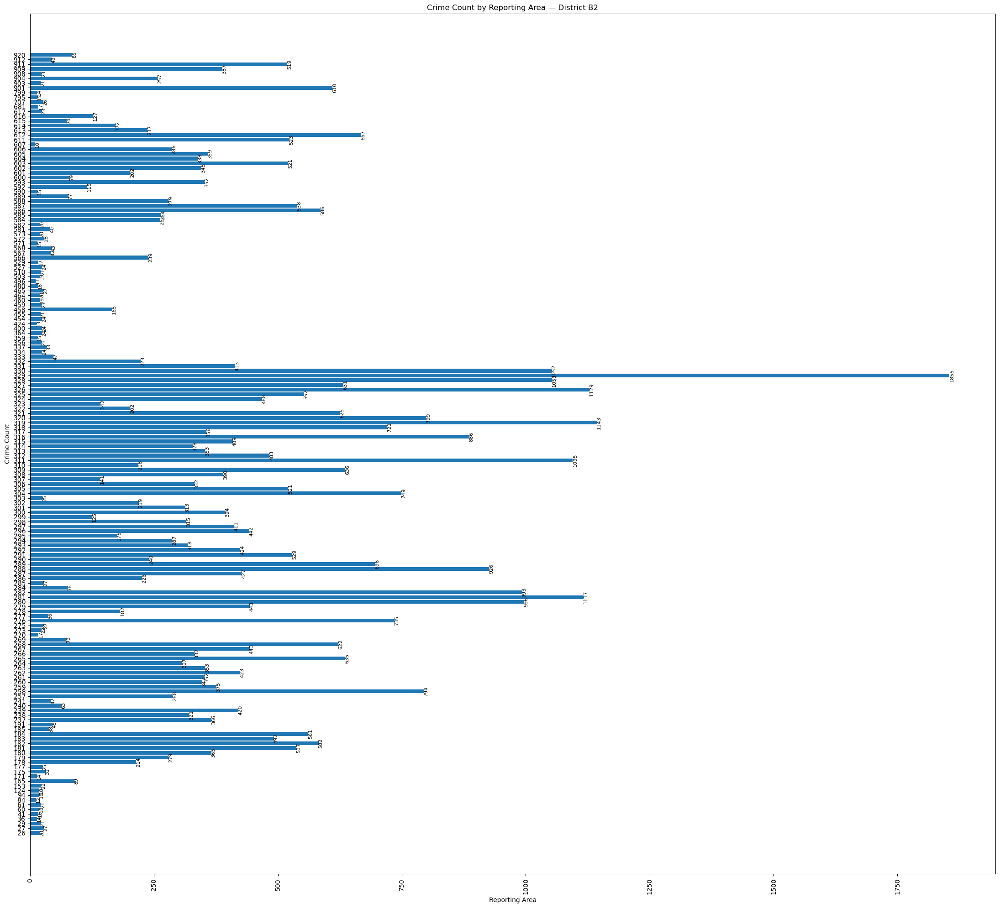

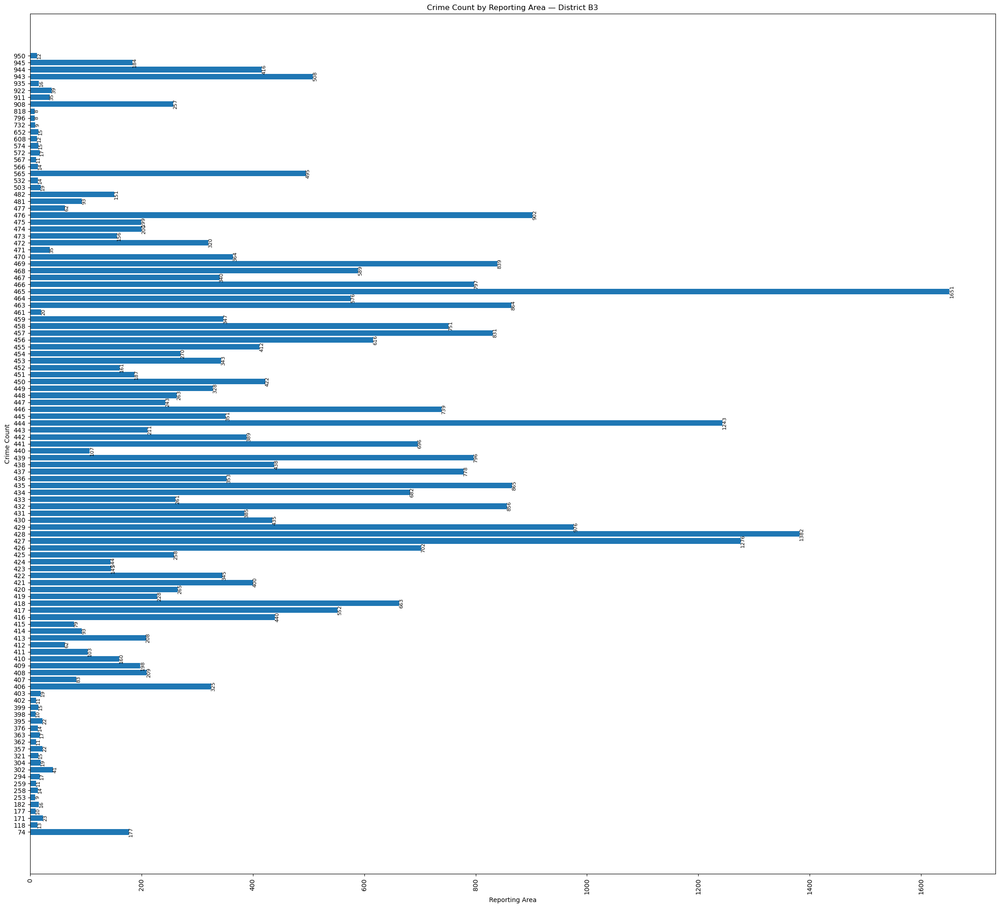

...

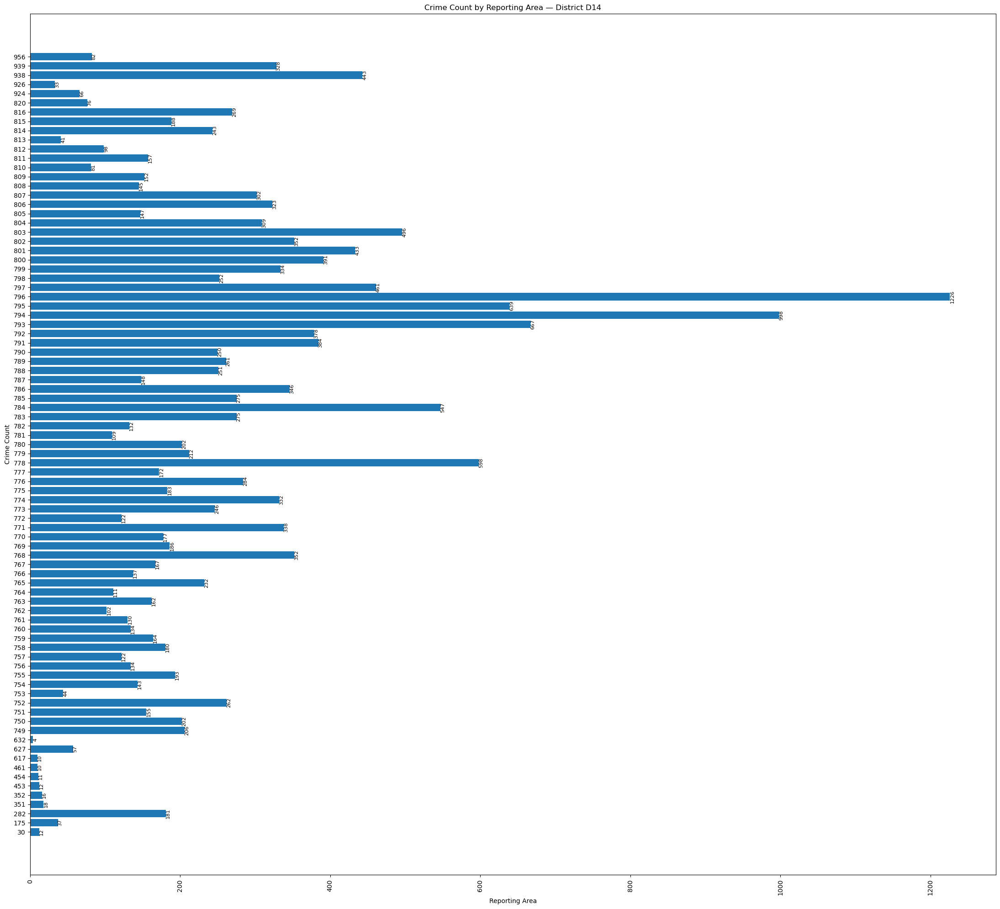

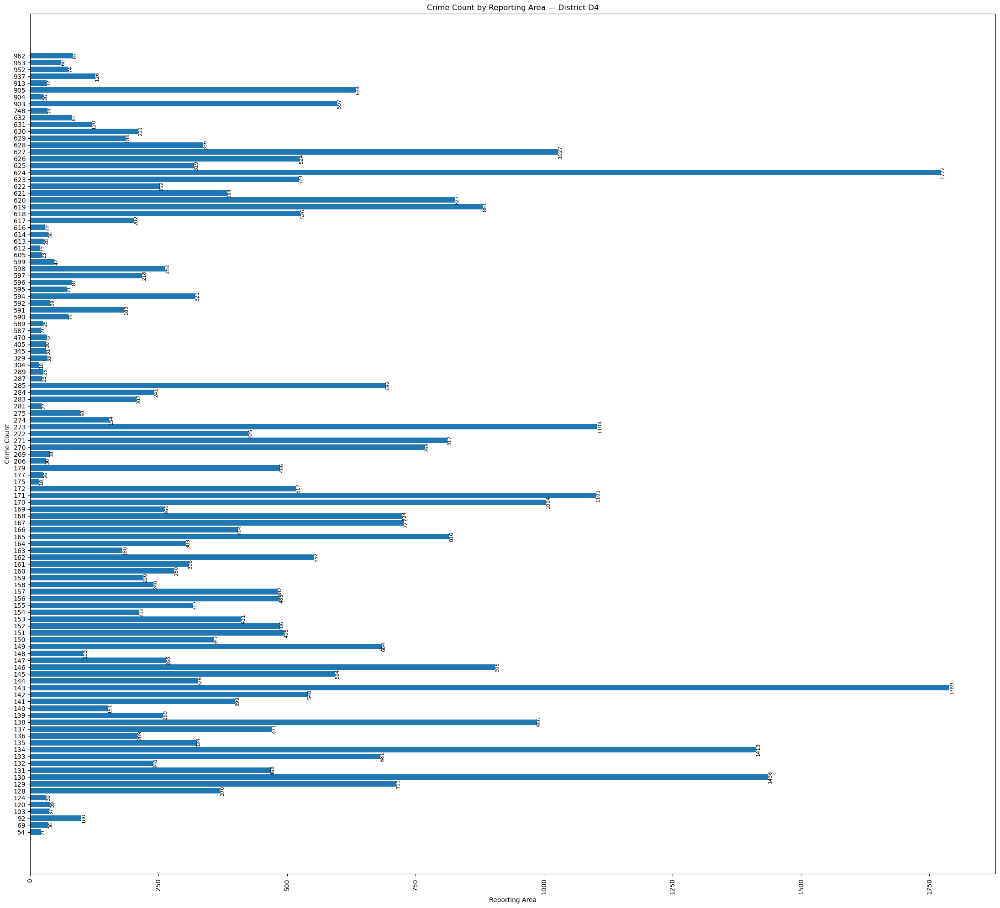

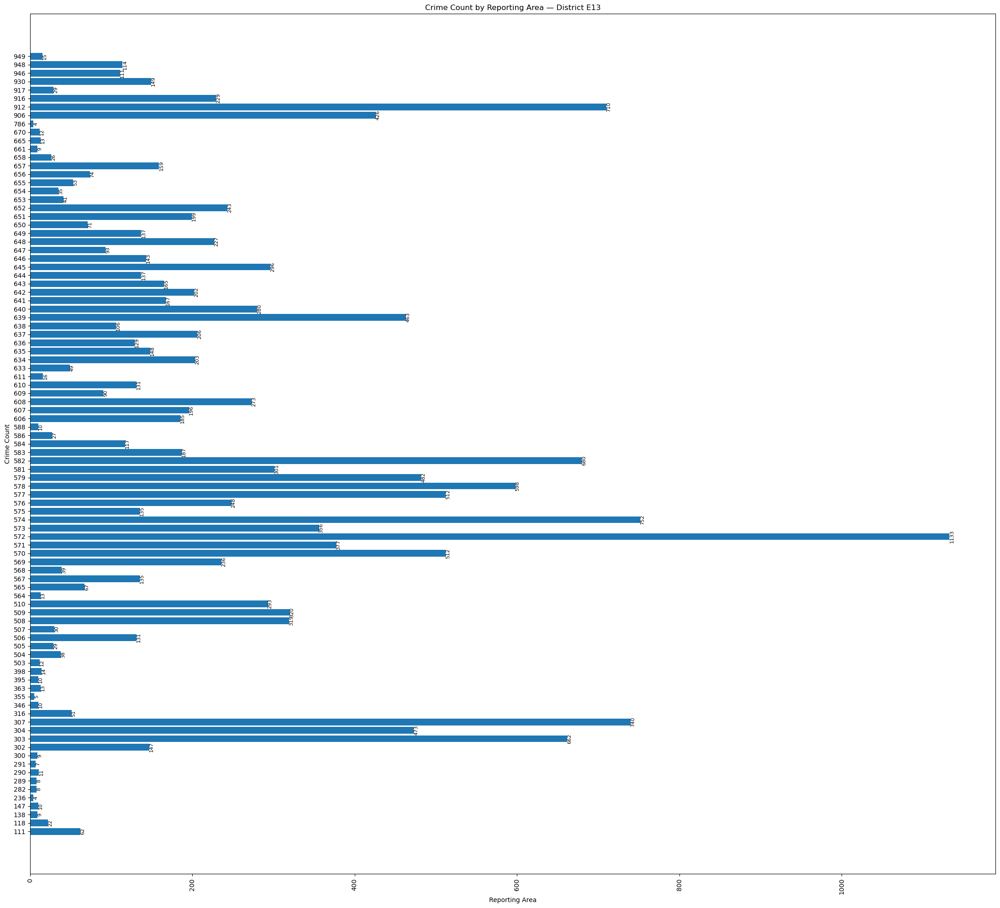

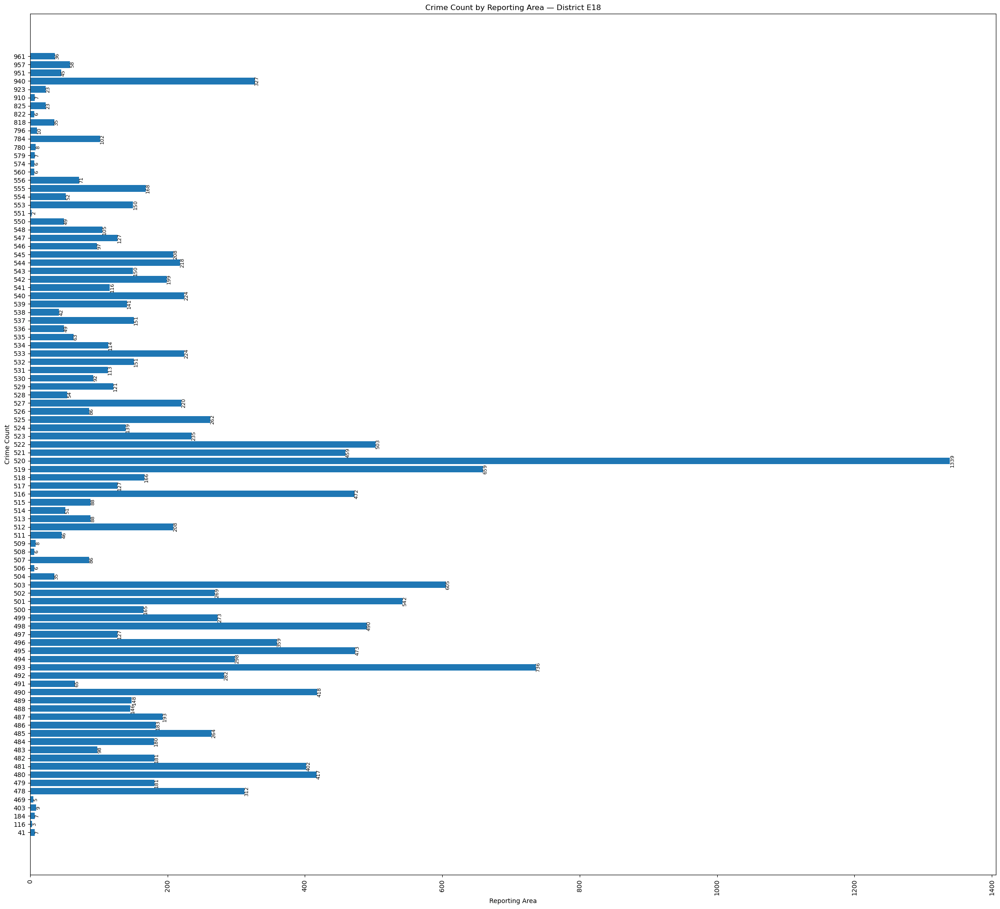

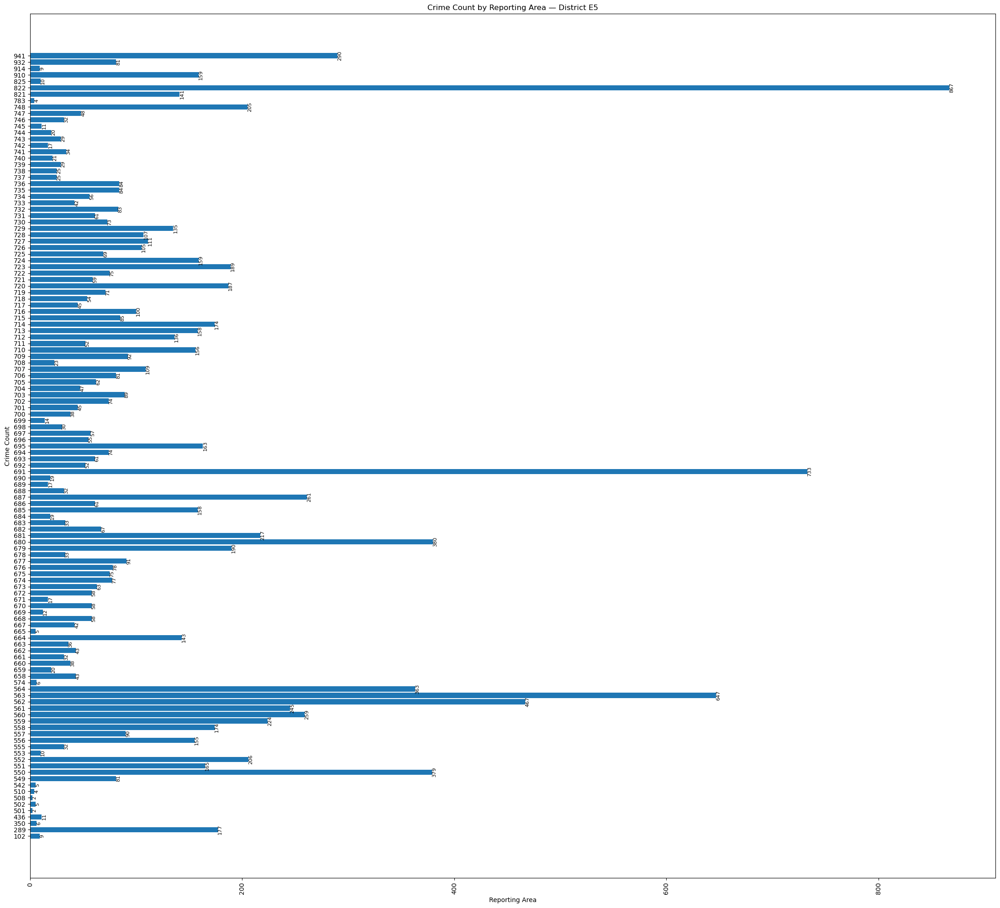

In [385]:
for dist in dist_reparea_crime_count.index.get_level_values(0).unique():

    temp = dist_reparea_crime_count.loc[dist]

    plt.figure(figsize=(22,20))

    bars = plt.barh(
        temp.index.astype(str),
        temp["Crime_Count"]
    )

    plt.bar_label(bars, fmt="%.0f", fontsize=8, rotation=90)

    plt.xlabel("Reporting Area")
    plt.ylabel("Crime Count")
    plt.title(f"Crime Count by Reporting Area — District {dist}")

    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()


In [386]:
# 4 hr dis ke hr rep area hr street ka crime count 
dist_reparea_street_crime_count

Crime_Count
DISTRICT REPORTING_AREA STREET                    
A1       41             ARCH ST                  2
                        ARLINGTON ST             1
                        BEACH ST                 1
                        BEVERLY ST               2
                        BOYLSTON ST              1
...                                            ...
E5       941            BROOKWAY RD            129
                        BROOKWAY TER            43
                        ELVEN RD                10
                        GROVE ST                 1
                        WASHINGTON ST           21

[16324 rows x 1 columns]

In [387]:
District_crime_count=District_crime_count.reset_index()

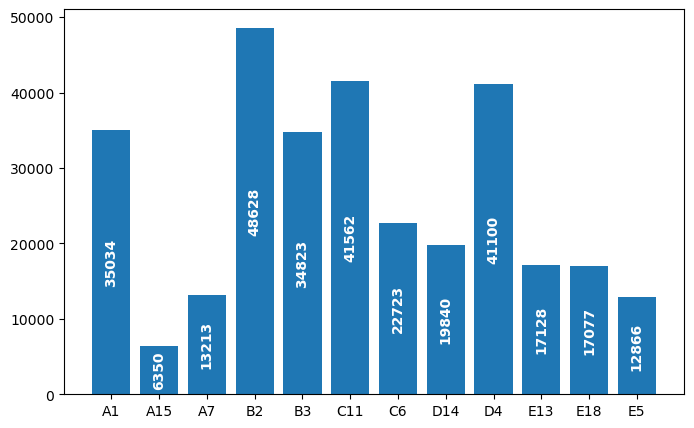

In [388]:
# 5. District_crime_count
plt.figure(figsize=(8,5))
b1=plt.bar(District_crime_count["DISTRICT"],District_crime_count["Crime_count"]
)
plt.bar_label(b1,label_type="center",color="white",fontsize="10",fontweight="bold",rotation=90)
plt.show()


In [389]:
# 6.Reporting_area_crime_count

In [390]:
top20_crimes_dist

,OFFENSE_CODE_GROUP,DISTRICT,Crime_Count
0,Larceny,D4,7302
1,Motor Vehicle Accident Response,B2,6343
2,Other,B2,3300
3,Medical Assistance,B2,3144
4,Verbal Disputes,B2,3006
5,Investigate Person,B2,2734
6,Simple Assault,B2,2505
7,Vandalism,B2,2433
8,Larceny From Motor Vehicle,D4,2006
9,Drug Violation,B2,1999


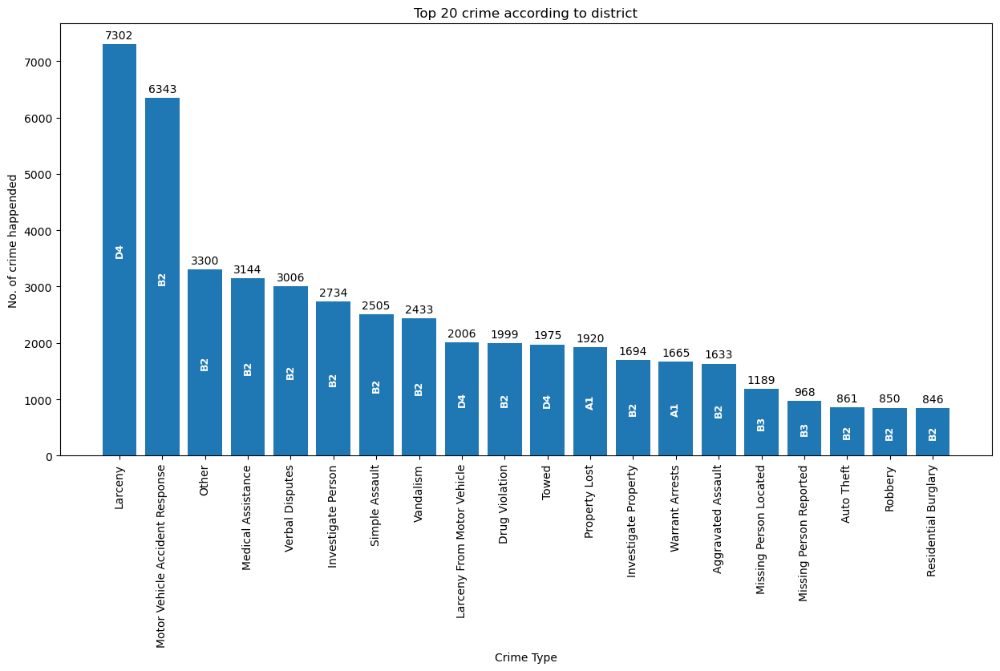

In [391]:
#7. top20_crimes_dist
plt.figure(figsize=(15,7))
b1=plt.bar(top20_crimes_dist["OFFENSE_CODE_GROUP"],top20_crimes_dist["Crime_Count"])
plt.bar_label(b1,labels=top20_crimes_dist["DISTRICT"],label_type="center",fontsize="9",fontweight="bold",color="white",rotation=90)
plt.bar_label(
    b1,
    padding=3
)
plt.xticks(rotation=90)
plt.xlabel("Crime Type")
plt.ylabel("No. of crime happended")
plt.title("Top 20 crime according to district")
plt.show()

In [392]:
top20_crimes_Rep

,OFFENSE_CODE_GROUP,REPORTING_AREA,Crime_Count
0,Larceny,143,872
1,Drug Violation,465,522
2,Investigate Property,61,398
3,Motor Vehicle Accident Response,186,303
4,Warrant Arrests,117,194
5,Other,111,186
6,Simple Assault,624,181
7,Liquor Violation,288,170
8,Investigate Person,900,165
9,Medical Assistance,26,160


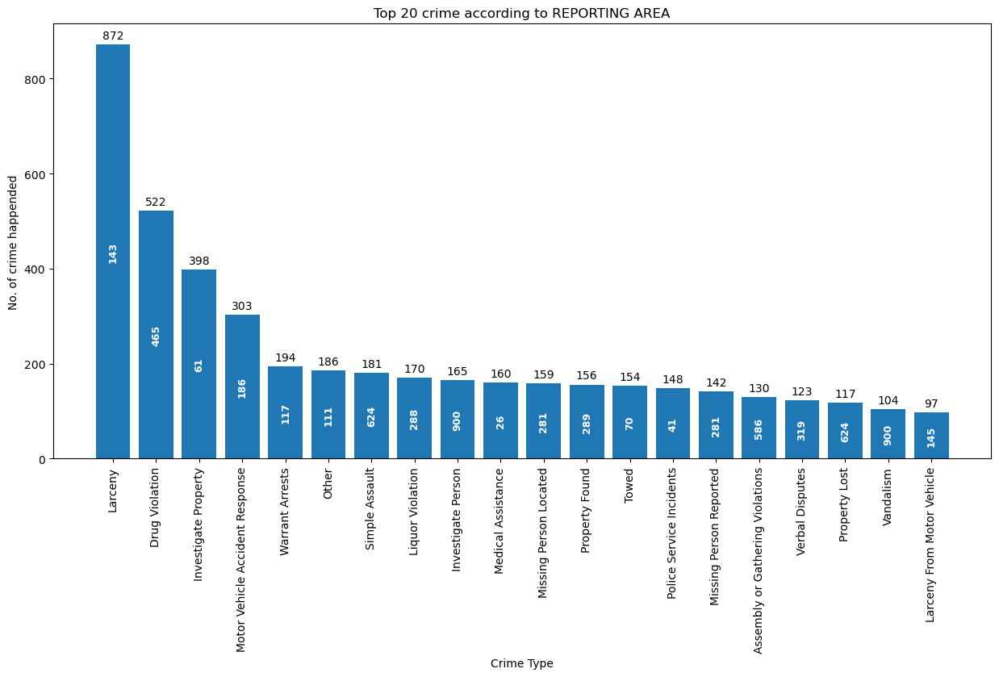

In [393]:
#8. top20_crimes_Rep
plt.figure(figsize=(15,7))
b1=plt.bar(top20_crimes_Rep["OFFENSE_CODE_GROUP"],top20_crimes_Rep["Crime_Count"])
plt.bar_label(b1,labels=top20_crimes_Rep["REPORTING_AREA"],label_type="center",fontsize="9",fontweight="bold",color="white",rotation=90)
plt.bar_label(
    b1,
    padding=3
)
plt.xticks(rotation=90)
plt.xlabel("Crime Type")
plt.ylabel("No. of crime happended")
plt.title("Top 20 crime according to REPORTING AREA")
plt.show()

In [394]:
top20_crimes_street

,OFFENSE_CODE_GROUP,STREET,Crime_Count
0,Larceny,BOYLSTON ST,2167
1,Motor Vehicle Accident Response,BLUE HILL AVE,1309
2,Drug Violation,WASHINGTON ST,1190
3,Other,WASHINGTON ST,1004
4,Medical Assistance,WASHINGTON ST,977
5,Investigate Person,WASHINGTON ST,812
6,Simple Assault,WASHINGTON ST,777
7,Property Lost,WASHINGTON ST,555
8,Vandalism,WASHINGTON ST,518
9,Warrant Arrests,WASHINGTON ST,465


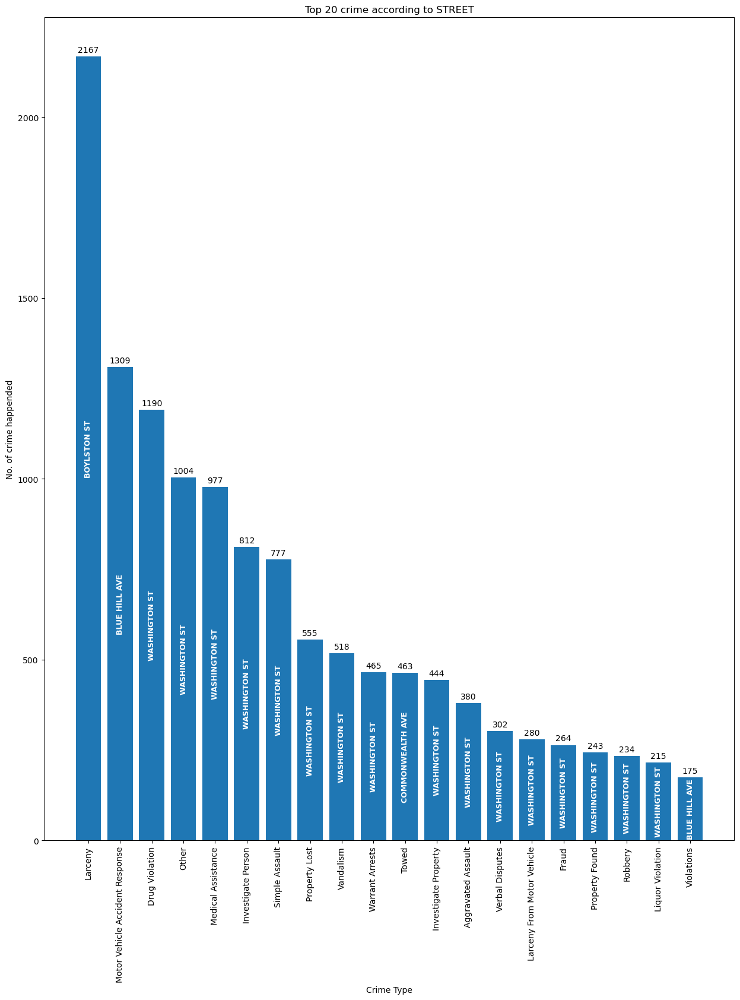

In [395]:
#9. top20_crimes_Street
plt.figure(figsize=(15,18))
b1=plt.bar(top20_crimes_street["OFFENSE_CODE_GROUP"],top20_crimes_street["Crime_Count"])
plt.bar_label(b1,labels=top20_crimes_street["STREET"],label_type="center",fontsize="9",fontweight="bold",color="white",rotation=90)
plt.bar_label(
    b1,
    padding=3
)
plt.xticks(rotation=90)
plt.xlabel("Crime Type")
plt.ylabel("No. of crime happended")
plt.title("Top 20 crime according to STREET")
plt.show()

In [396]:
top5_streets_per_crime

,OFFENSE_CODE_GROUP,STREET,Crime_Count
0,Investigate Person,WASHINGTON ST,812
1,Investigate Person,BLUE HILL AVE,489
2,Investigate Person,CENTRE ST,305
3,Investigate Person,BOYLSTON ST,271
4,Investigate Person,DORCHESTER AVE,269
5,Larceny,BOYLSTON ST,2167
6,Larceny,WASHINGTON ST,1936
7,Larceny,NEWBURY ST,858
8,Larceny,HUNTINGTON AVE,829
9,Larceny,TREMONT ST,603


In [397]:
top5_streets_per_crime
heatmap_df = pd.pivot_table(
    top5_streets_per_crime,
    index="OFFENSE_CODE_GROUP",
    columns="STREET",
    values="Crime_Count",
    fill_value=0
)


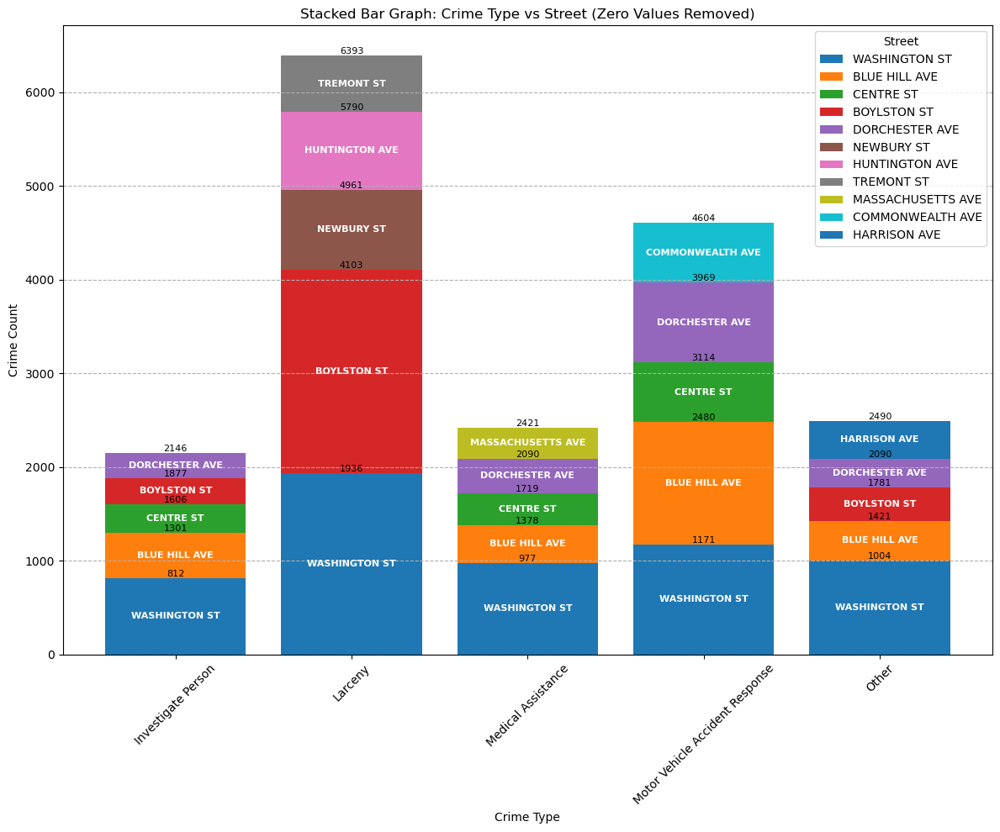

In [398]:
# 10 top5_streets_per_crime
crime_types = top5_streets_per_crime["OFFENSE_CODE_GROUP"].unique()
streets = top5_streets_per_crime["STREET"].unique()

x = np.arange(len(crime_types))
bottom = np.zeros(len(x))

plt.figure(figsize=(12,10))

for street in streets:

    temp = top5_streets_per_crime[top5_streets_per_crime["STREET"] == street]

    counts = (
        temp.set_index("OFFENSE_CODE_GROUP")
            .reindex(crime_types)["Crime_Count"]
            .fillna(0)
    )

    # mask non-zero only
    mask = counts > 0

    bars = plt.bar(
        x[mask],
        counts[mask],
        bottom=bottom[mask],
        label=street
    )

    # label values only where bar exists
    plt.bar_label(bars, fmt="%.0f", fontsize=8)

    # center label = street only for real bars
    plt.bar_label(
        bars,
        labels=[street]*len(bars),
        label_type="center",
        color="white",
        fontsize=8,
        fontweight="bold"
    )

    bottom[mask] += counts[mask].values

plt.xticks(x, crime_types, rotation=45)
plt.xlabel("Crime Type")
plt.ylabel("Crime Count")
plt.title("Stacked Bar Graph: Crime Type vs Street (Zero Values Removed)")
plt.legend(title="Street", bbox_to_anchor=(1,1))
plt.grid(axis="y", linestyle="--")
plt.tight_layout()
plt.show()


In [399]:
top5_reparea_per_crime

,REPORTING_AREA,OFFENSE_CODE_GROUP,Crime_Count
0,900,Investigate Person,165
1,691,Investigate Person,159
2,465,Investigate Person,151
3,367,Investigate Person,146
4,914,Investigate Person,133
5,143,Larceny,872
6,134,Larceny,578
7,186,Larceny,524
8,111,Larceny,400
9,627,Larceny,390


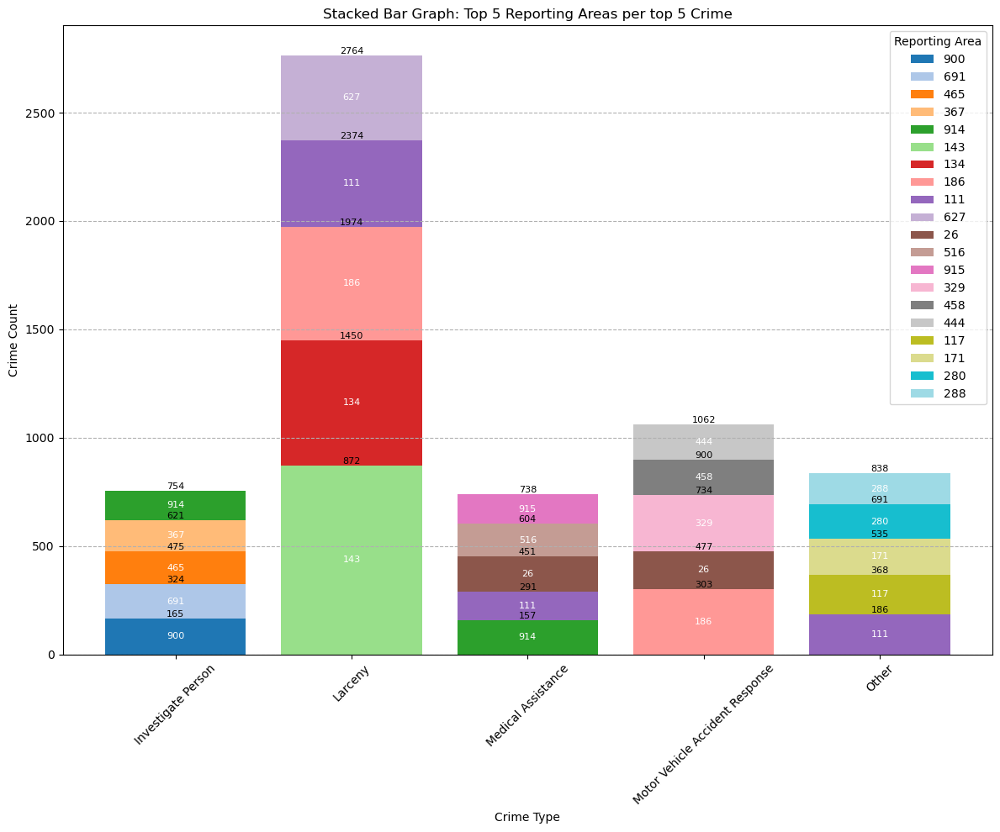

In [400]:
# 11 top5_reparea_per_crime
import matplotlib.cm as cm

crime_types = top5_reparea_per_crime["OFFENSE_CODE_GROUP"].unique()
areas = top5_reparea_per_crime["REPORTING_AREA"].unique()

x = np.arange(len(crime_types))
bottom = np.zeros(len(x))

# create many distinct colors
colors = cm.tab20(np.linspace(0, 1, len(areas)))

plt.figure(figsize=(12,10))

for area, color in zip(areas, colors):

    temp = top5_reparea_per_crime[top5_reparea_per_crime["REPORTING_AREA"] == area]

    counts = (
        temp.set_index("OFFENSE_CODE_GROUP")
            .reindex(crime_types)["Crime_Count"]
            .fillna(0)
    )

    mask = counts > 0

    bars = plt.bar(
        x[mask],
        counts[mask],
        bottom=bottom[mask],
        color=color,
        label=str(area)
    )

    # value on top
    plt.bar_label(bars, fmt="%.0f", fontsize=8)

    # area label inside
    plt.bar_label(
        bars,
        labels=[str(area)] * len(bars),
        label_type="center",
        color="white",
        fontsize=8
    )

    bottom[mask] += counts[mask].values

plt.xticks(x, crime_types, rotation=45)
plt.xlabel("Crime Type")
plt.ylabel("Crime Count")
plt.title("Stacked Bar Graph: Top 5 Reporting Areas per top 5 Crime")
plt.legend(title="Reporting Area", bbox_to_anchor=(1,1))
plt.grid(axis="y", linestyle="--")
plt.tight_layout()
plt.show()

In [401]:
top5_dist_per_crime

,DISTRICT,OFFENSE_CODE_GROUP,Crime_Count
0,B2,Investigate Person,2734
1,C11,Investigate Person,2676
2,B3,Investigate Person,2458
3,D4,Investigate Person,2082
4,A1,Investigate Person,1601
5,D4,Larceny,7302
6,A1,Larceny,4680
7,B2,Larceny,2867
8,C11,Larceny,2181
9,C6,Larceny,1866


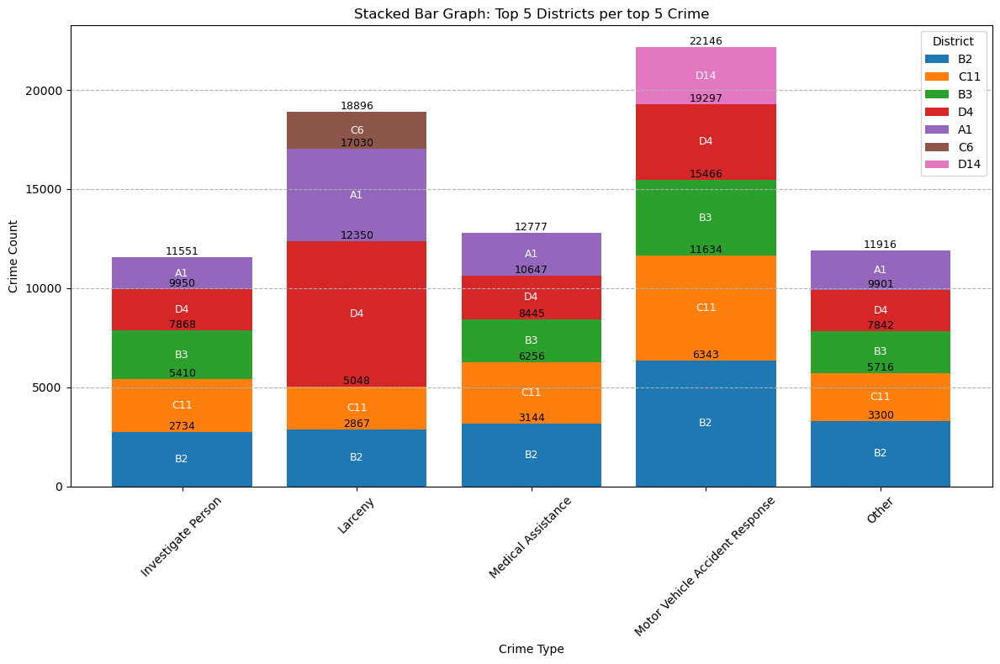

In [402]:
# 12  top5_dist_per_crime
crime_types = top5_dist_per_crime["OFFENSE_CODE_GROUP"].unique()
districts = top5_dist_per_crime["DISTRICT"].unique()

x = np.arange(len(crime_types))
bottom = np.zeros(len(x))

plt.figure(figsize=(12,8))

for dist in districts:

    temp = top5_dist_per_crime[top5_dist_per_crime["DISTRICT"] == dist]

    counts = (
        temp.set_index("OFFENSE_CODE_GROUP")
            .reindex(crime_types)["Crime_Count"]
            .fillna(0)
    )

    mask = counts > 0

    bars = plt.bar(
        x[mask],
        counts[mask],
        bottom=bottom[mask],
        label=dist
    )

    # value on top
    plt.bar_label(bars, fmt="%.0f", fontsize=9)

    # district name inside bar
    plt.bar_label(
        bars,
        labels=[dist] * len(bars),
        label_type="center",
        color="white",
        fontsize=9
    )

    bottom[mask] += counts[mask].values

plt.xticks(x, crime_types, rotation=45)
plt.xlabel("Crime Type")
plt.ylabel("Crime Count")
plt.title("Stacked Bar Graph: Top 5 Districts per top 5 Crime")
plt.legend(title="District", bbox_to_anchor=(1,1))
plt.grid(axis="y", linestyle="--")
plt.tight_layout()
plt.show()


In [403]:
top10street_highest_crime_rate=top10street_highest_crime_rate.reset_index()
top10street_highest_crime_rate


,STREET,Crime_count
0,WASHINGTON ST,14193
1,BLUE HILL AVE,7792
2,BOYLSTON ST,7307
3,DORCHESTER AVE,5163
4,MASSACHUSETTS AVE,4824
5,TREMONT ST,4822
6,HARRISON AVE,4648
7,CENTRE ST,4342
8,COMMONWEALTH AVE,4188
9,HYDE PARK AVE,3460


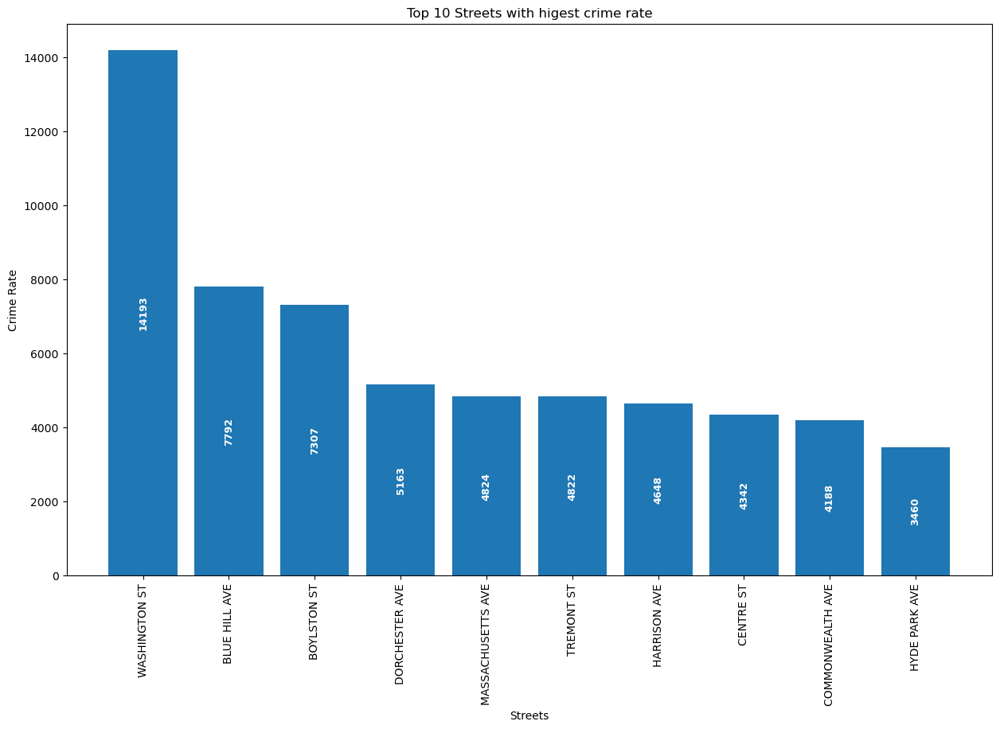

In [404]:
# 13 top10street_highest_crime_rate
plt.figure(figsize=(15,9))
b1=plt.bar(top10street_highest_crime_rate["STREET"],top10street_highest_crime_rate["Crime_count"])
plt.bar_label(b1,label_type="center",color="white",fontsize='9',fontweight="bold",rotation=90)
plt.xticks(rotation=90)
plt.ylabel("Crime Rate")
plt.xlabel("Streets")
plt.title("Top 10 Streets with higest crime rate")
plt.show()

In [405]:
offense_code_group_crime=offense_code_group_crime.sort_values("Crime_count",ascending=False).head(10)

In [406]:
offense_code_group_crime=offense_code_group_crime.reset_index()
offense_code_group_crime

,OFFENSE_CODE,OFFENSE_CODE_GROUP,Crime_count
0,3006,Medical Assistance,18682
1,3115,Investigate Person,18616
2,3831,Motor Vehicle Accident Response,16076
3,1402,Vandalism,15065
4,802,Simple Assault,14693
5,3301,Verbal Disputes,13069
6,3410,Towed,11189
7,3114,Investigate Property,10944
8,617,Larceny,9036
9,2647,Other,9003


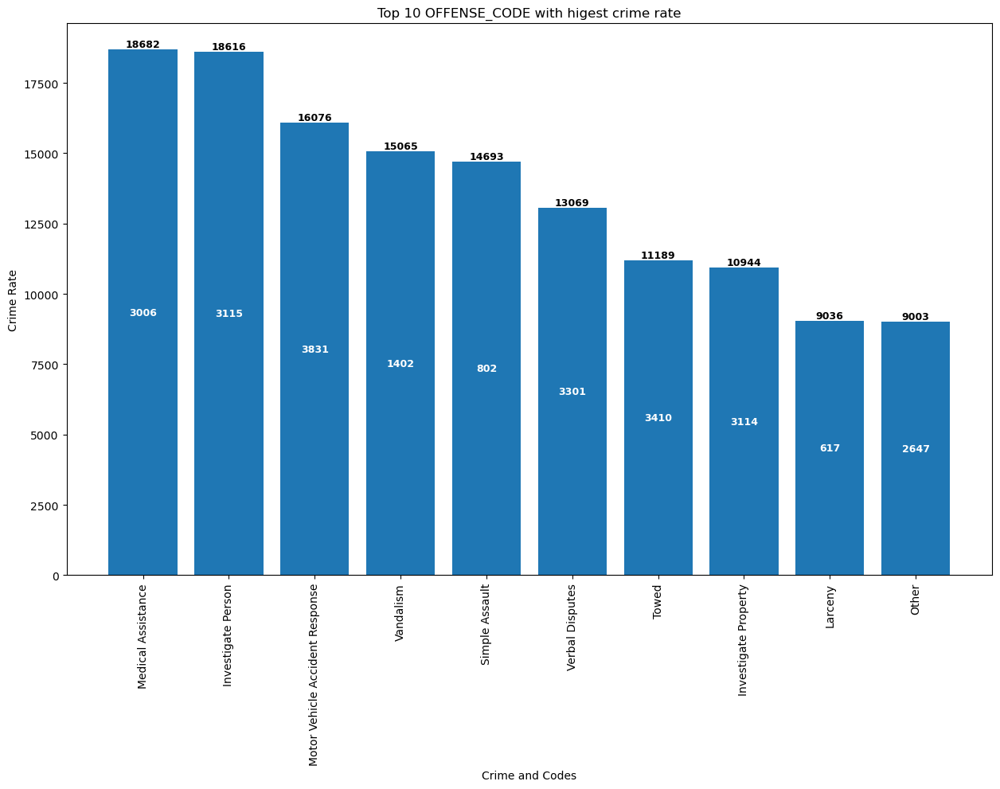

In [407]:
# 14 . offense_code_group_crime
plt.figure(figsize=(15,9))
x=str(offense_code_group_crime["OFFENSE_CODE"])
b1=plt.bar(offense_code_group_crime["OFFENSE_CODE_GROUP"],offense_code_group_crime["Crime_count"])
plt.bar_label(b1,color="black",fontsize='9',fontweight="bold")
plt.bar_label(b1,labels=offense_code_group_crime["OFFENSE_CODE"],label_type="center",color="white",fontsize='9',fontweight="bold")
plt.xticks(rotation=90)
plt.ylabel("Crime Rate")
plt.xlabel("Crime and Codes")
plt.title("Top 10 OFFENSE_CODE with higest crime rate")
plt.show()

In [408]:
dist_month_day_crime

,DISTRICT,Month,Day,Crime_Count
0,A1,1,1,109
1,A1,1,2,72
2,A1,1,3,89
3,A1,1,4,84
4,A1,1,5,68
...,...,...,...,...
4387,E5,12,27,25
4388,E5,12,28,22
4389,E5,12,29,23
4390,E5,12,30,24


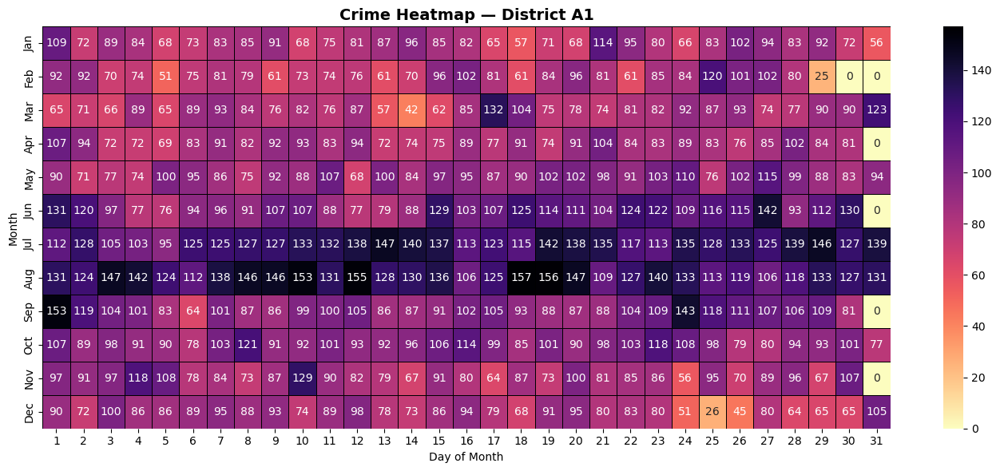

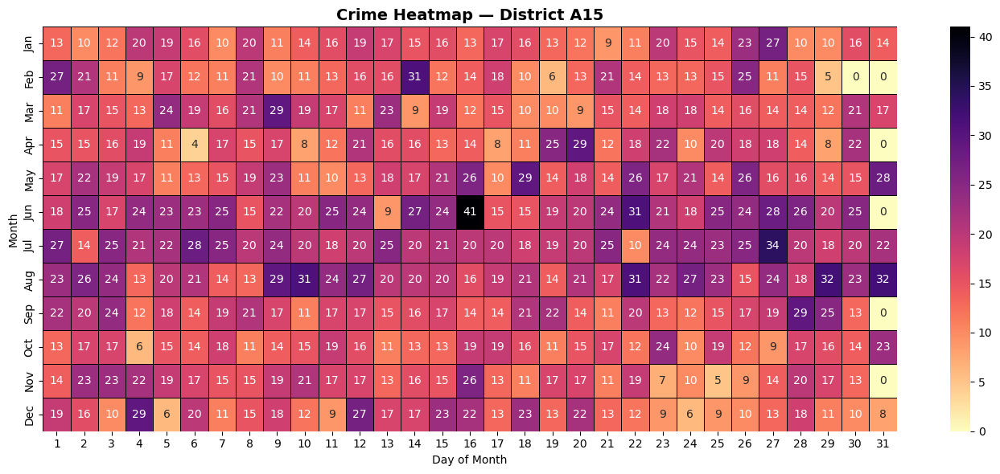

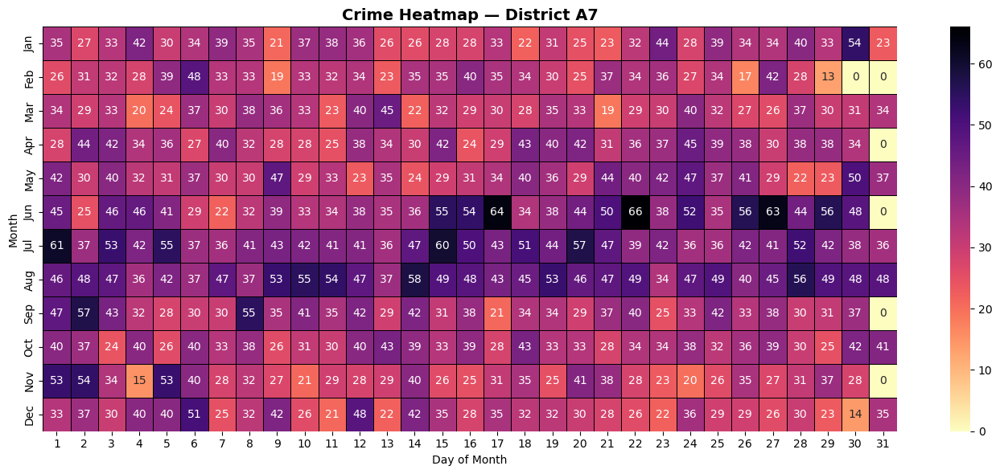

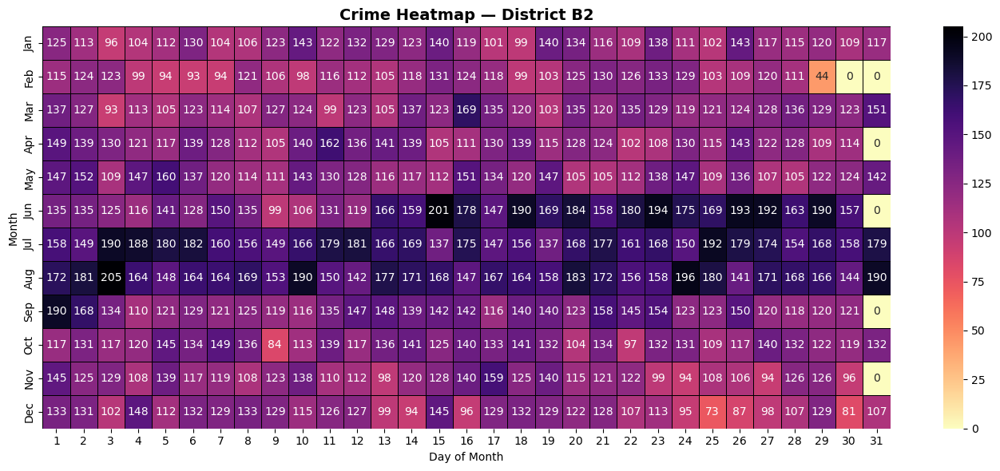

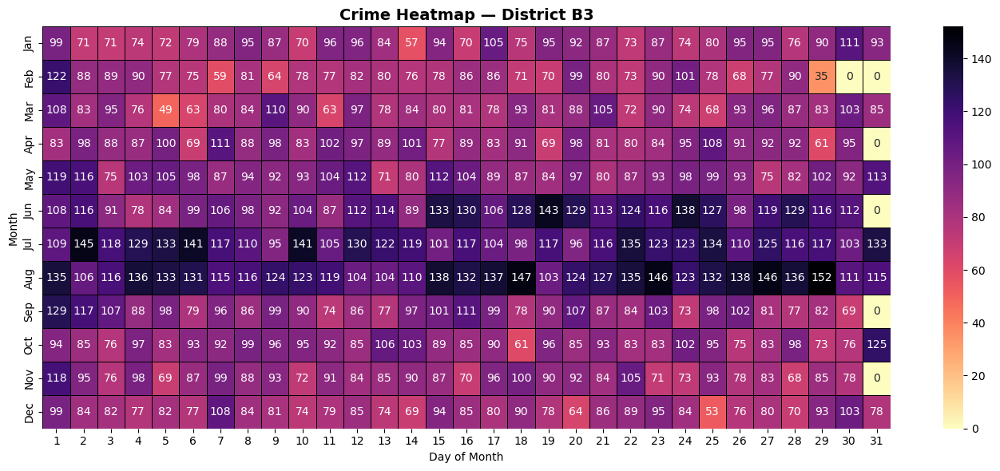

...

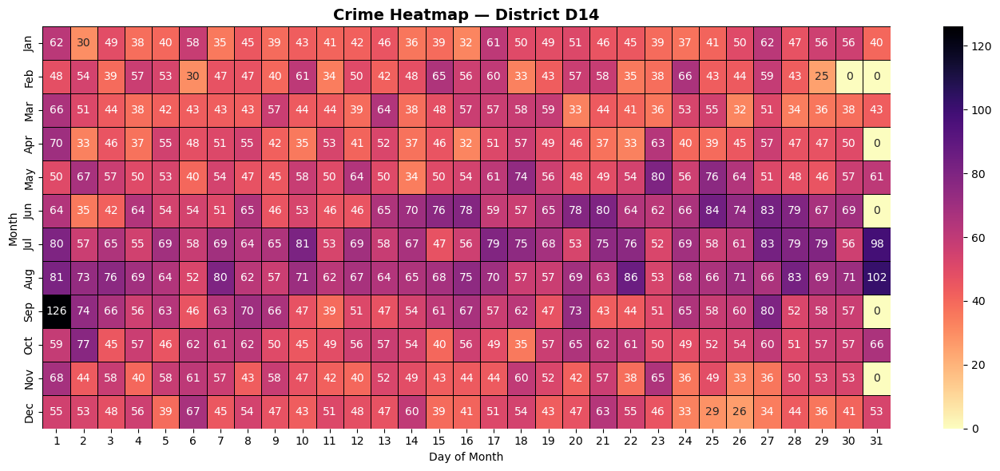

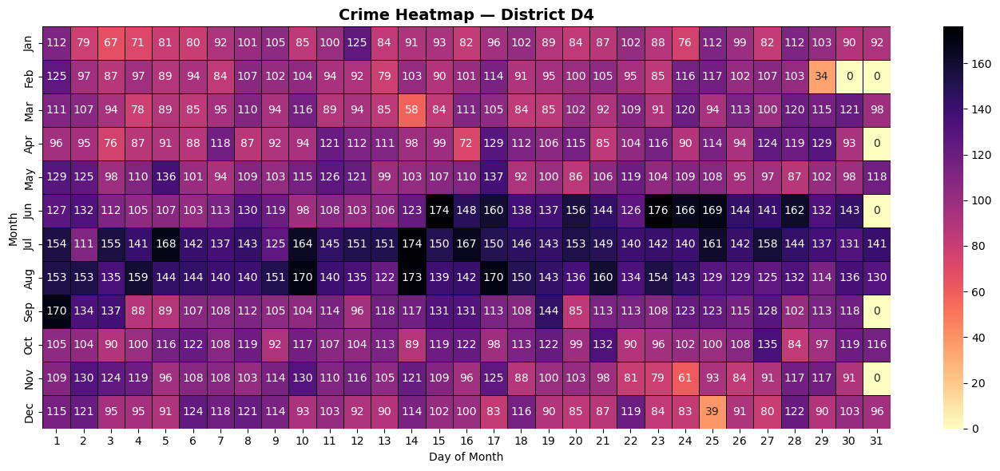

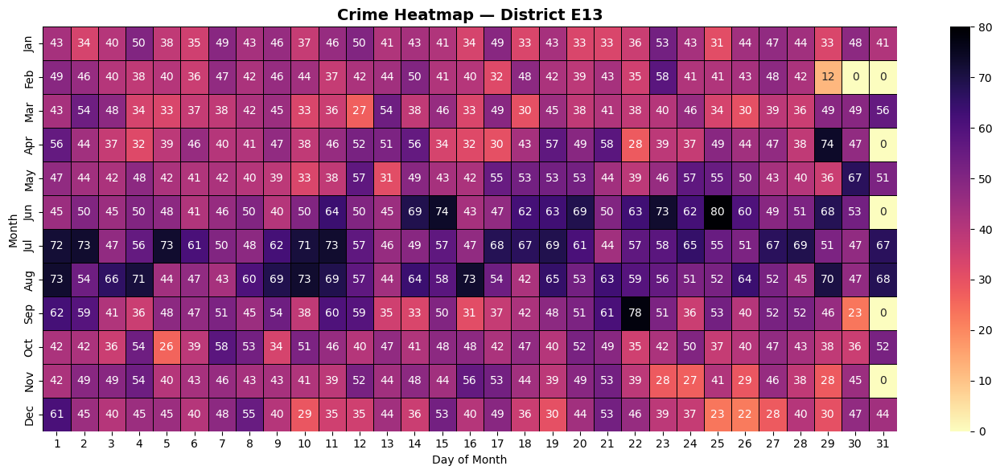

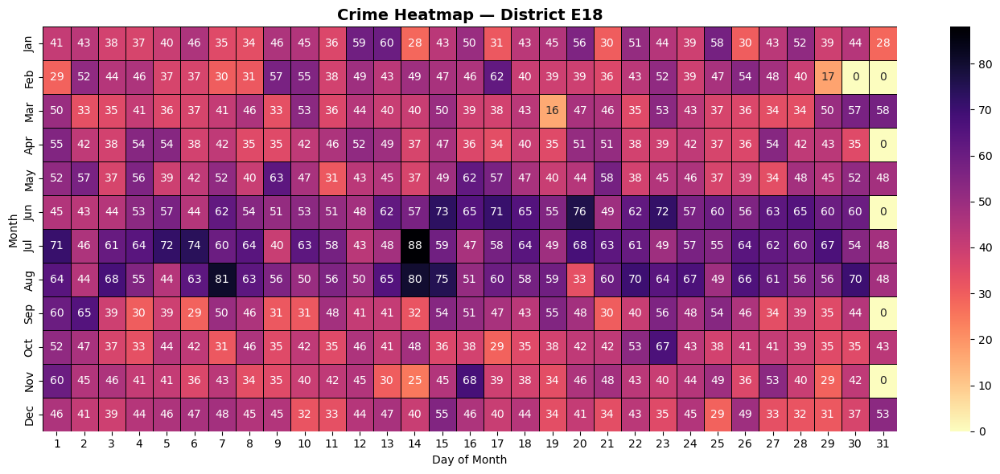

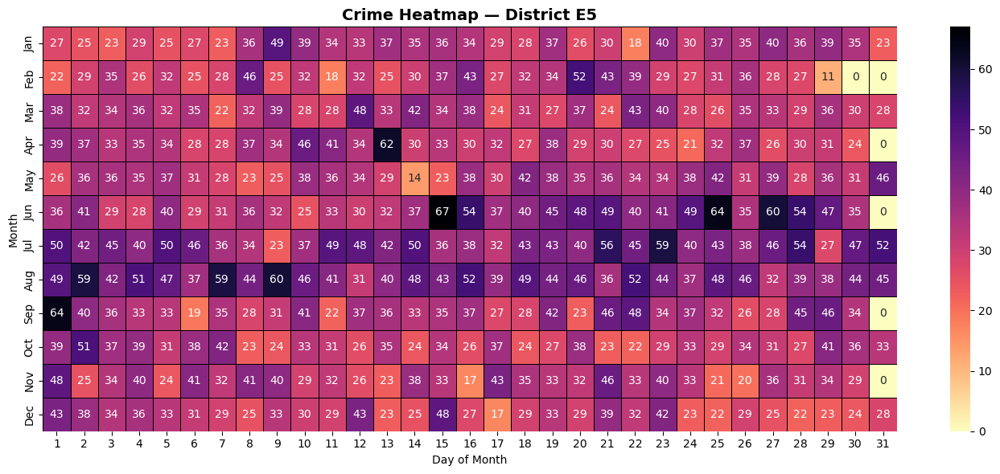

In [409]:
#15 dist_month_day_crime
month_map = {
    1:"Jan", 2:"Feb", 3:"Mar", 4:"Apr", 5:"May", 6:"Jun",
    7:"Jul", 8:"Aug", 9:"Sep", 10:"Oct", 11:"Nov", 12:"Dec"
}

dist_month_day_crime["Month_Name"] = dist_month_day_crime["Month"].map(month_map)


for dist in dist_month_day_crime["DISTRICT"].unique():

    temp = dist_month_day_crime[dist_month_day_crime["DISTRICT"] == dist]

    heatmap_data = pd.pivot_table(temp,
        index="Month_Name",
        columns="Day",
        values="Crime_Count",
        fill_value=0
    )

   
    heatmap_data = heatmap_data.reindex(
        ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
    )

    plt.figure(figsize=(14,6))

    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt="d",
        cmap="magma_r",
        linewidths=0.5,
        linecolor="black",
        
    )

    plt.xlabel("Day of Month")
    plt.ylabel("Month")
    plt.title(f"Crime Heatmap — District {dist}", fontsize=14, fontweight="bold")

    plt.tight_layout()
    plt.show()


In [410]:
week_hour_crime

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,2101,1223,919,517,429,462,743,1371,1977,2245,...,2515,2508,2987,3140,2924,2499,2247,2035,2109,1887
Monday,1930,1012,798,574,373,408,691,1322,1999,2073,...,2430,2388,2957,3156,2995,2540,2261,1946,1604,1210
Saturday,2531,1812,1771,931,654,456,509,1052,1464,1757,...,2320,2026,2398,2477,2464,2234,2078,2035,2051,1923
Sunday,2341,2000,1805,1082,690,505,531,731,1101,1434,...,1985,1879,2179,2303,2263,2075,2060,1854,1686,1352
Thursday,1977,1019,748,513,423,489,843,1381,1978,2264,...,2460,2449,2890,2852,2934,2448,2298,2022,1742,1452
Tuesday,1840,971,607,442,392,453,762,1395,2081,2260,...,2486,2449,2980,3146,3113,2705,2317,1874,1707,1267
Wednesday,1943,893,760,395,357,433,793,1417,2071,2303,...,2535,2421,2985,3045,3001,2650,2222,2001,1691,1262


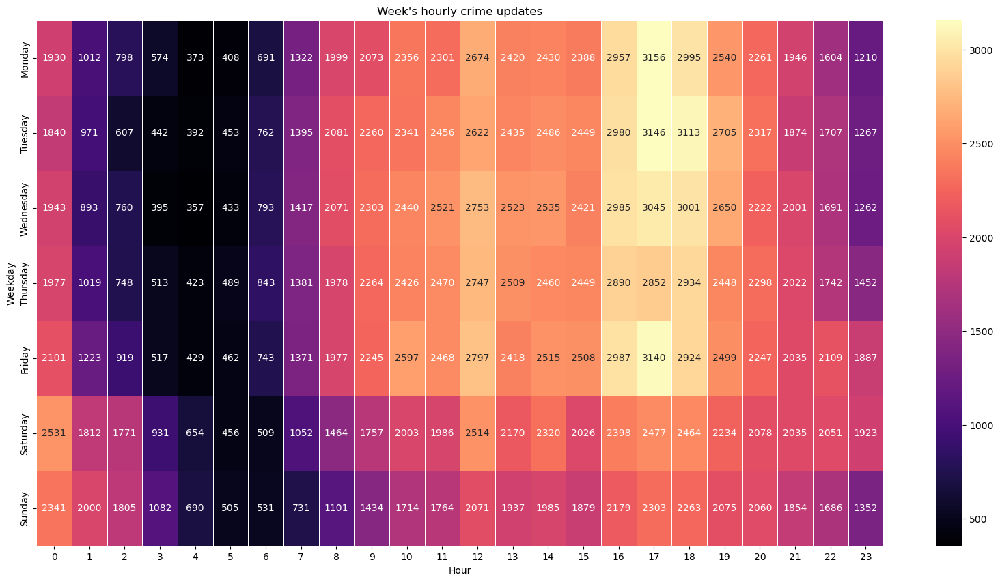

In [411]:
#16. week_hour_crime
week_hour_crime = week_hour_crime.reindex(
    ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]
)

plt.figure(figsize=(20,10))
sns.heatmap(week_hour_crime,annot=True,fmt="d",cmap="magma",linecolor="white",linewidths=0.5)
plt.title("Week's hourly crime updates")
plt.show()

In [412]:
month_day_crime

Day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
Month,,,,,,,,,,,,,,,,,,,,,
1,868,676,666,693,715,742,719,741,778,712,...,720,801,660,753,816,788,776,785,773,685
2,856,782,704,703,694,692,653,749,670,751,...,696,779,816,767,759,818,729,268,0,0
3,823,744,721,668,625,708,737,759,803,762,...,735,749,773,716,764,765,749,760,835,866
4,873,813,738,739,785,730,865,737,740,742,...,692,779,827,797,793,838,788,812,748,0
5,888,912,742,858,893,798,771,758,819,810,...,795,882,885,812,862,742,739,760,823,910
6,931,903,810,802,819,817,924,893,798,831,...,1100,1122,1131,1172,1118,1157,1067,1087,1063,0
7,1111,1033,1077,1053,1164,1132,1014,1034,959,1141,...,1084,1079,1059,1122,1039,1147,1096,1096,1016,1150
8,1166,1074,1202,1127,1029,1042,1085,1048,1120,1195,...,1137,1086,1110,1036,1041,1030,1075,1082,1048,1122
9,1264,1059,919,723,772,706,794,871,822,765,...,905,898,858,916,870,836,844,818,738,0


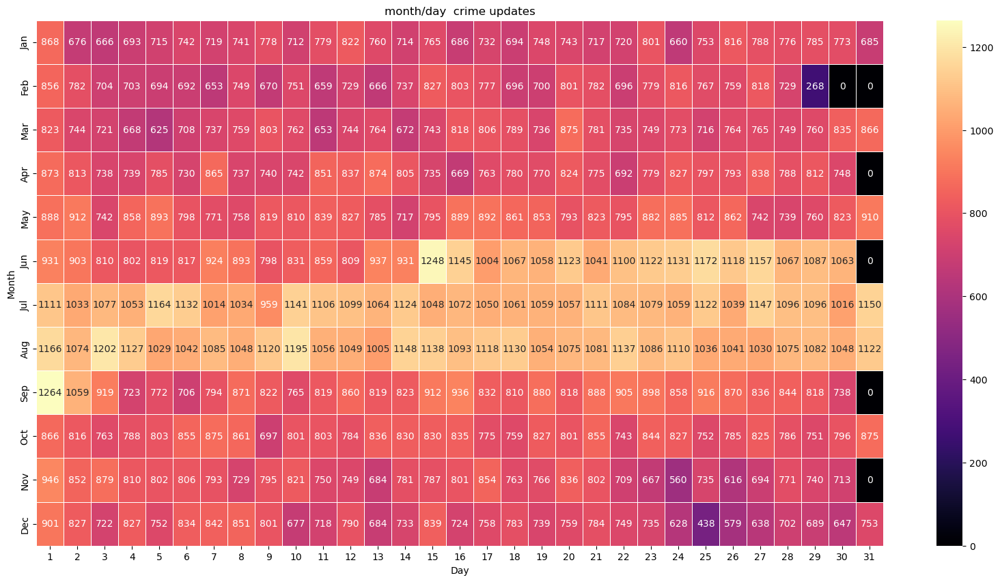

In [413]:
#17. month_day_crime
month_day_crime.index = month_day_crime.index.map(month_map)
plt.figure(figsize=(20,10))
sns.heatmap(month_day_crime,annot=True,fmt="d",cmap="magma",linecolor="white",linewidths=0.5)
plt.title("month/day  crime updates")
plt.show()




In [414]:
dist_week_hour_crime

Hour                 0    1    2    3   4   5   6    7    8    9   ...   14  \
DISTRICT Weekday                                                   ...        
A1       Friday     309  249  213   72  53  48  61  137  203  249  ...  254   
         Monday     227  183  149   68  27  34  59  127  185  215  ...  247   
         Saturday   392  390  412  146  90  48  61  128  161  197  ...  227   
         Sunday     360  425  431  171  61  49  51   75  136  131  ...  201   
         Thursday   230  183  120   81  55  35  56  134  201  264  ...  246   
...                 ...  ...  ...  ...  ..  ..  ..  ...  ...  ...  ...  ...   
E5       Saturday    92   48   49   32  23  14  13   38   44   80  ...   84   
         Sunday      87   64   41   39  21  22  24   15   42   61  ...   80   
         Thursday    84   31   25   11  19  30  55   59   90  121  ...  110   
         Tuesday     92   46   20   20  20  26  45   71  104  131  ...  116   
         Wednesday   84   18   21   17   9  25  44   58   96  104  ...  125   

Hour                 15   16   17   18   19   20   21   22   23  
DISTRICT Weekday                                                 
A1       Friday     305  327  352  302  226  227  182  231  263  
         Monday     248  303  372  316  245  220  159  150   98  
         Saturday   222  296  332  328  253  238  222  259  287  
         Sunday     154  242  311  266  200  198  159  170  127  
         Thursday   274  322  359  342  246  216  174  175  185  
...                 ...  ...  ...  ...  ...  ...  ...  ...  ...  
E5       Saturday    97  113   93   95   81   71   70   91   68  
         Sunday      90   81   88   80   77   88   85   69   61  
         Thursday   118  117  120  113   88   85   81   62   59  
         Tuesday    104  129  110  120   95  100   60   50   48  
         Wednesday  111  122  103  136   98   82   72   74   48  

[84 rows x 24 columns]

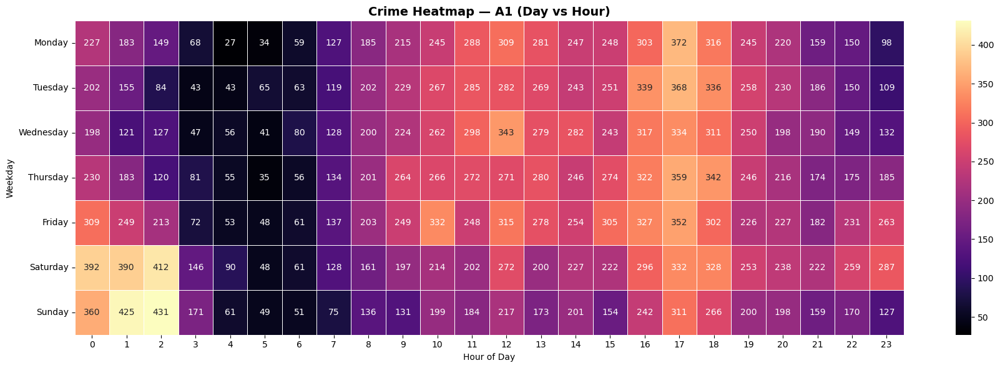

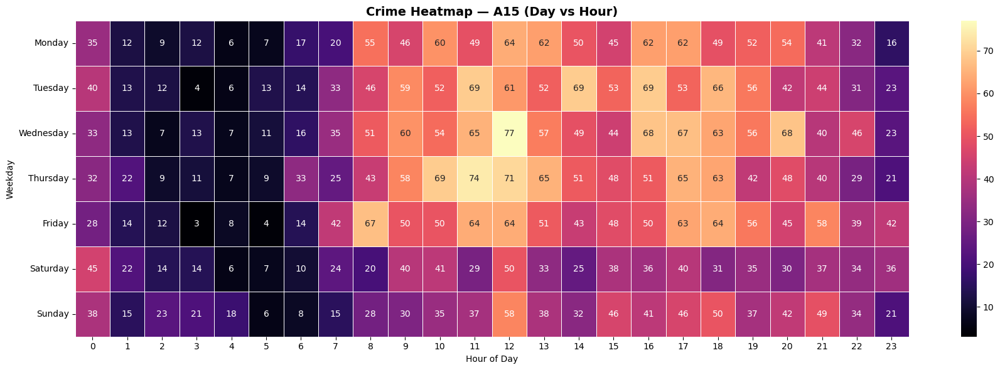

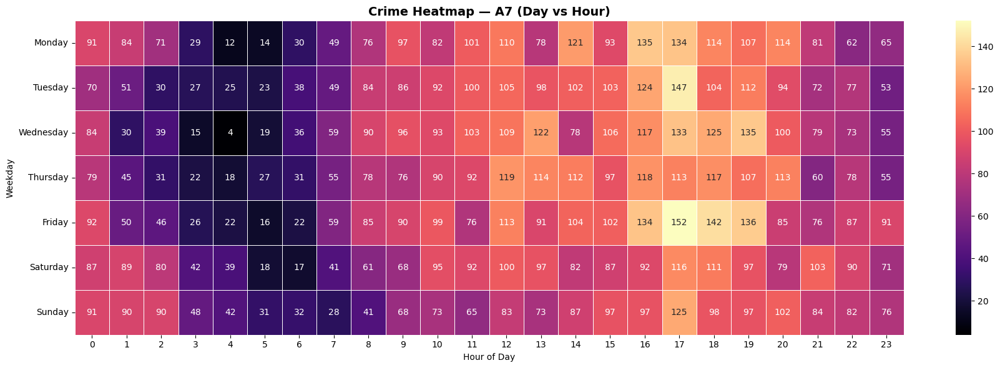

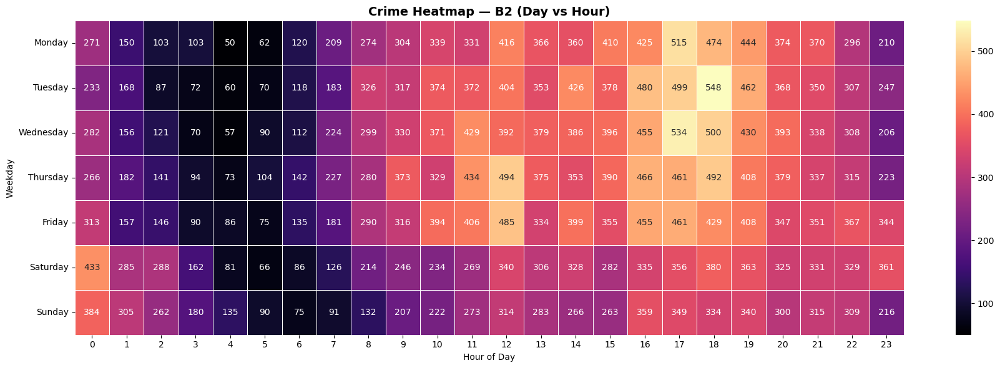

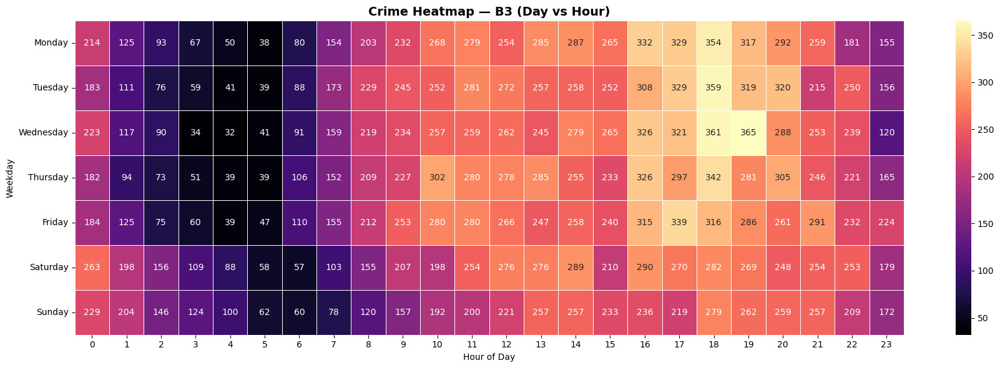

...

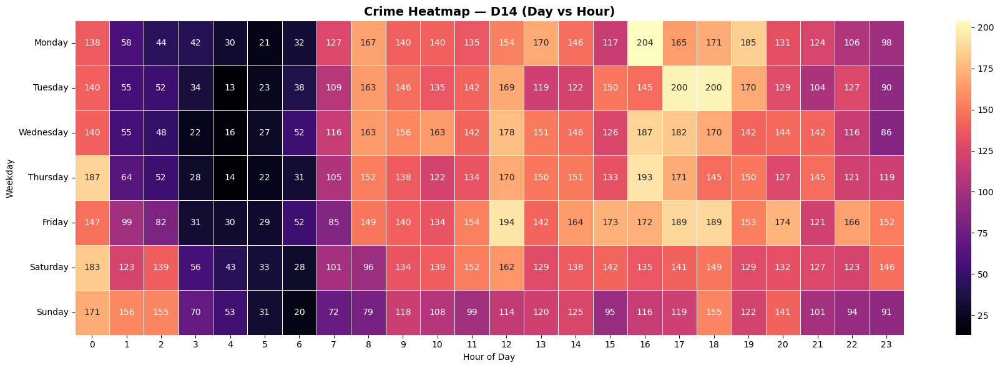

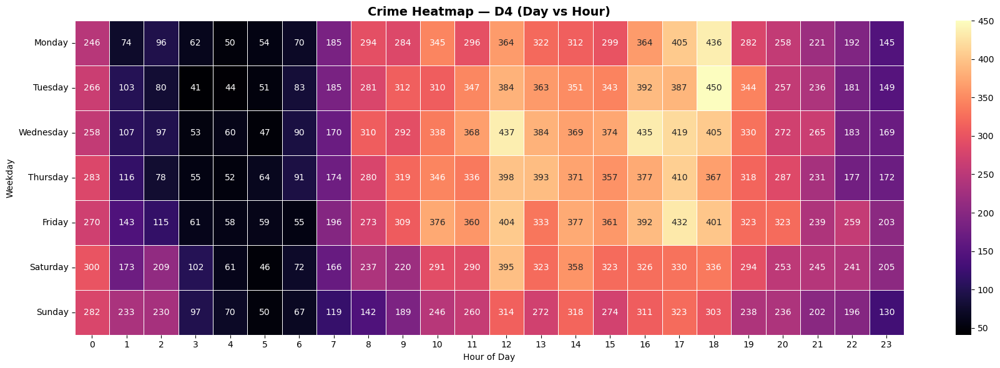

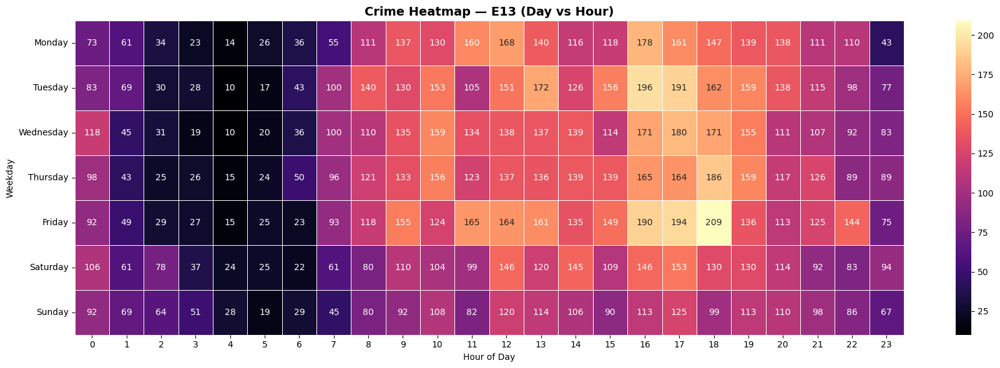

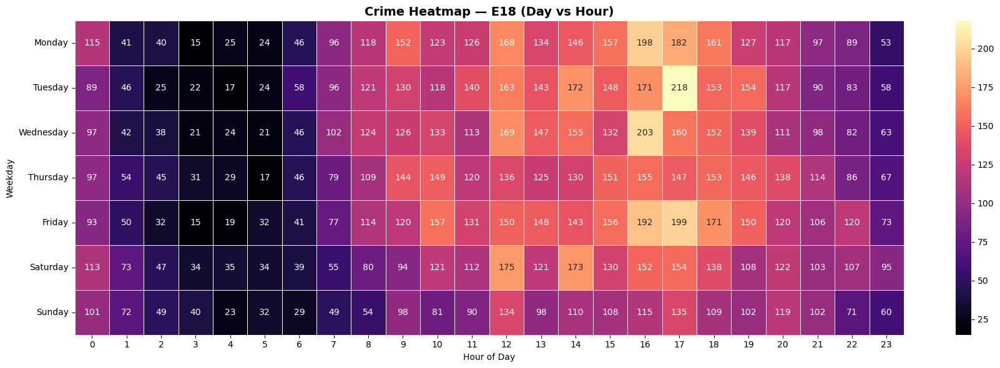

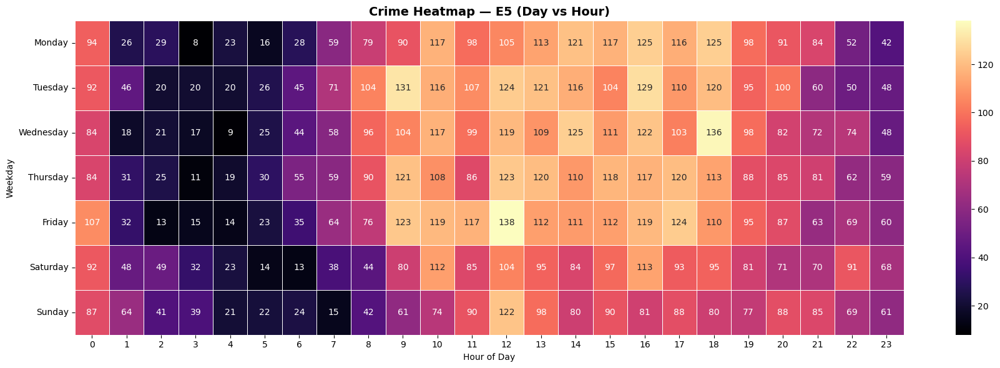

In [415]:
#18  dist_week_hour_crime


week_hour_crime = dist_week_hour_crime


day_order = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

for dist in week_hour_crime.index.get_level_values(0).unique():

    heatmap_data = week_hour_crime.loc[dist].reindex(day_order)

    plt.figure(figsize=(18,6))

    sns.heatmap(
        heatmap_data,
        annot=True,
        fmt="d",
        cmap="magma",
        linewidths=0.4,
        linecolor="white"
    )

    plt.xlabel("Hour of Day")
    plt.ylabel("Weekday")
    plt.title(f"Crime Heatmap — {dist} (Day vs Hour)", fontsize=14, fontweight="bold")

    plt.tight_layout()
    plt.show()


In [416]:
crime_occured_time

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Crime,,,,,,,,,,,,,,,,,,,,,
Aggravated Assault,452,417,377,180,134,71,91,135,212,224,...,341,379,468,408,447,430,416,440,432,407
Aircraft,0,0,0,1,0,1,0,0,1,0,...,2,4,2,3,3,3,1,2,0,1
Arson,7,4,6,5,3,3,3,2,3,6,...,4,4,3,7,4,3,4,4,3,3
Assembly or Gathering Violations,187,94,36,21,11,7,10,19,17,21,...,24,21,34,26,20,15,20,21,56,147
Auto Theft,260,131,103,83,68,52,93,118,167,199,...,237,221,256,265,306,292,314,289,299,244
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Towed,449,234,170,126,95,168,298,1206,1435,1316,...,288,215,346,373,318,311,316,331,245,192
Vandalism,806,531,478,264,216,221,318,500,626,622,...,620,635,784,859,967,889,938,872,890,763
Verbal Disputes,526,344,255,197,127,114,186,320,437,491,...,699,695,717,737,821,859,855,868,803,605


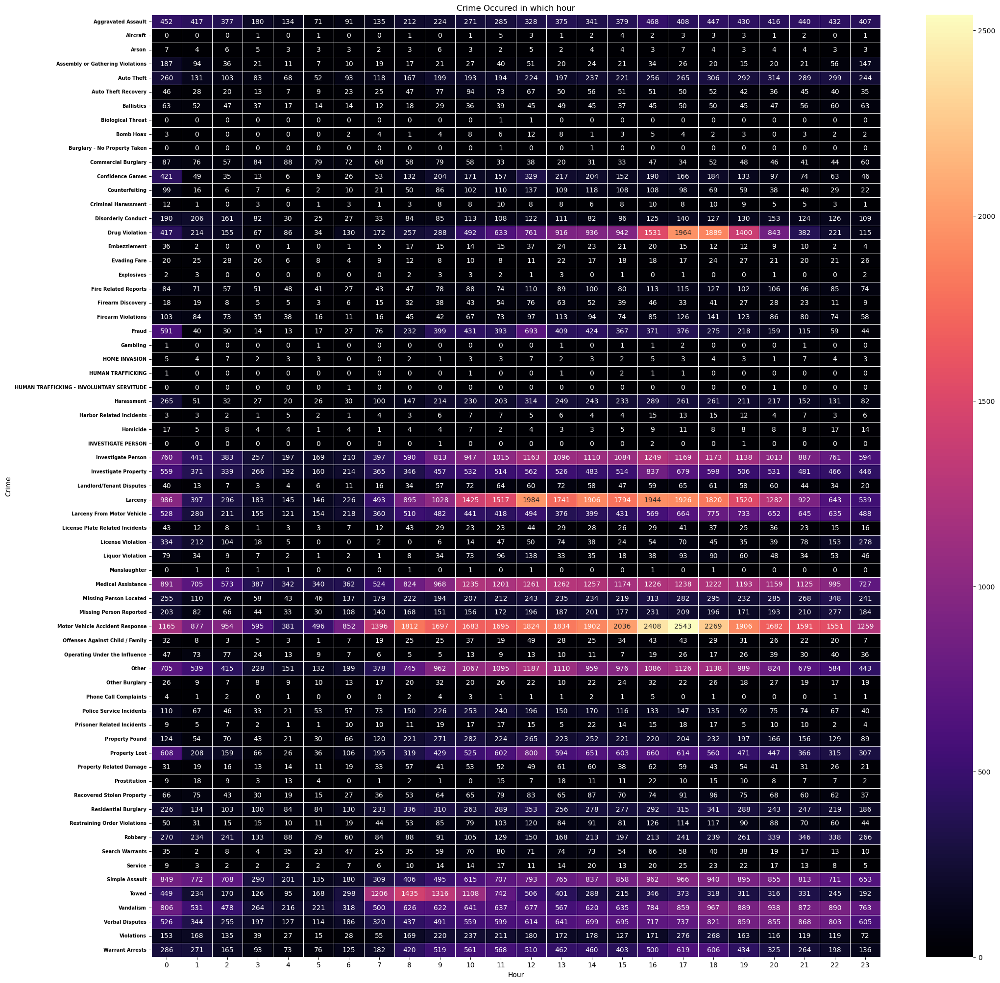

In [417]:
#19 crime_occured_time
plt.figure(figsize=(24,25))
sns.heatmap(crime_occured_time,annot=True,fmt="d",linecolor="white",cmap="magma",linewidths=0.5)
plt.title("Crime Occured in which hour")
plt.yticks(fontsize=7,fontweight="bold")
plt.show()


In [418]:
crime_peak_time

,OFFENSE_CODE_GROUP,Peak_Hour,Crime_Count
0,Aggravated Assault,16,468
1,Aircraft,11,5
2,Arson,0,7
3,Assembly or Gathering Violations,0,187
4,Auto Theft,20,314
...,...,...,...
62,Towed,8,1435
63,Vandalism,18,967
64,Verbal Disputes,21,868
65,Violations,17,276


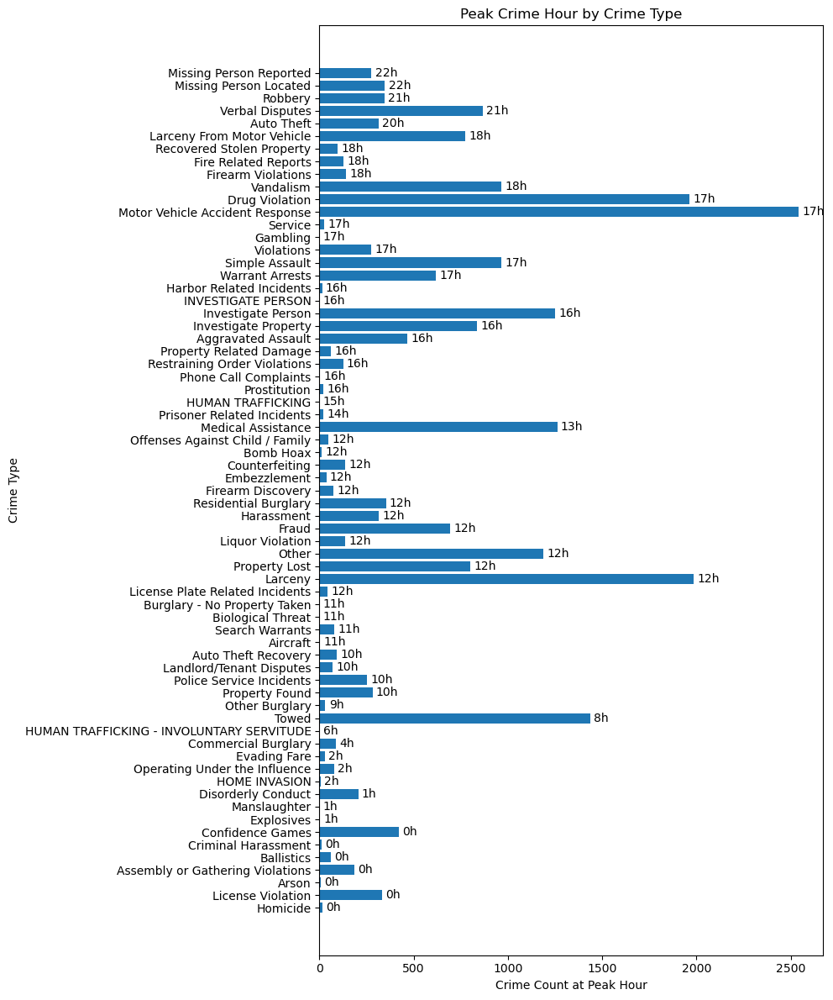

In [419]:
# 20 crime_peak_time
plot_df = crime_peak_time.sort_values("Peak_Hour")

plt.figure(figsize=(10,12))

bars = plt.barh(
    plot_df["OFFENSE_CODE_GROUP"],
    plot_df["Crime_Count"]
)

plt.bar_label(
    bars,
    labels=plot_df["Peak_Hour"].astype(str) + "h",
    padding=3
)

plt.xlabel("Crime Count at Peak Hour")
plt.ylabel("Crime Type")
plt.title("Peak Crime Hour by Crime Type")

plt.tight_layout()
plt.show()


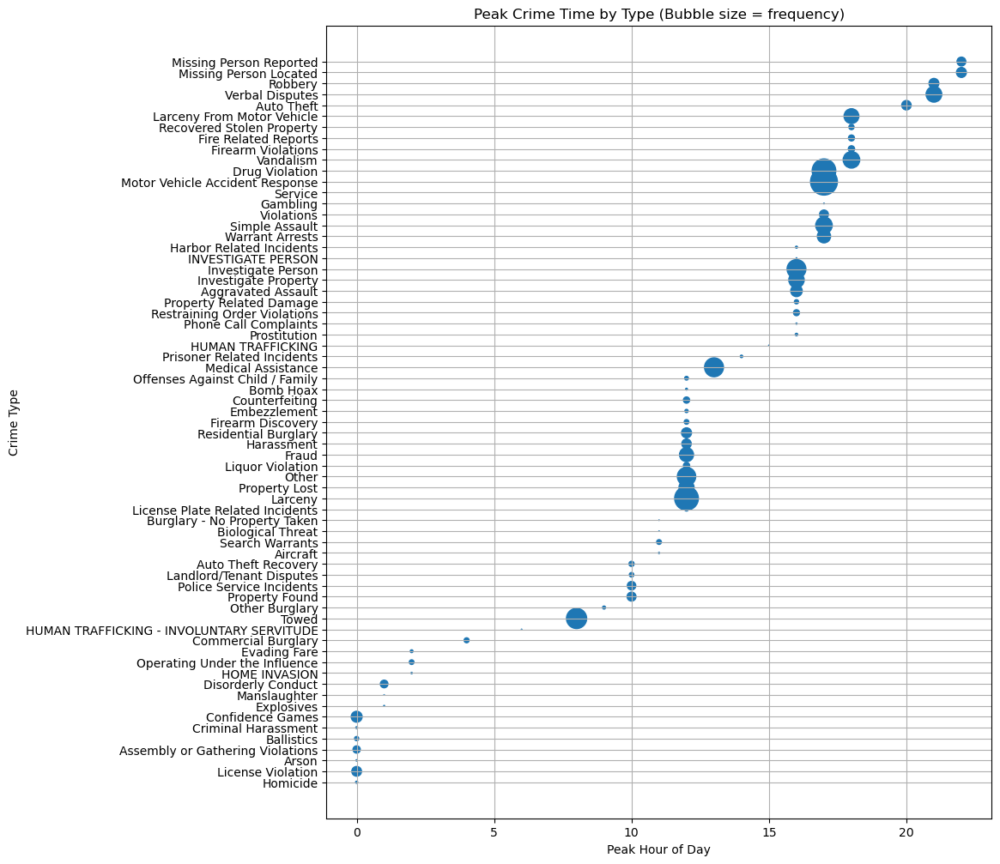

In [420]:
plt.figure(figsize=(10,12))

plt.scatter(
    plot_df["Peak_Hour"],
    plot_df["OFFENSE_CODE_GROUP"],
    s=plot_df["Crime_Count"]/5
)

plt.xlabel("Peak Hour of Day")
plt.ylabel("Crime Type")
plt.title("Peak Crime Time by Type (Bubble size = frequency)")
plt.grid(True)

plt.show()


In [421]:
dist_month_trend

DISTRICT,A1,A15,A7,B2,B3,C11,C6,D14,D4,E13,E18,E5
Month,,,,,,,,,,,,
1,2526,468,1010,3692,2631,3160,1683,1405,2862,1281,1314,995
2,2288,431,913,3223,2320,2837,1514,1375,2809,1206,1246,901
3,2541,492,966,3834,2617,3105,1844,1431,3049,1261,1281,1022
4,2546,464,1052,3781,2680,3145,1790,1394,3067,1331,1279,990
5,2839,550,1074,3947,2936,3520,1740,1704,3344,1420,1430,1029
6,3184,673,1298,4685,3339,3900,2173,1896,4002,1660,1733,1224
7,3942,672,1368,5153,3682,4557,2448,2074,4555,1838,1837,1331
8,4090,680,1440,5179,3914,4392,2509,2137,4425,1806,1842,1388
9,3017,519,1079,4037,2765,3443,1864,1803,3467,1419,1306,1056


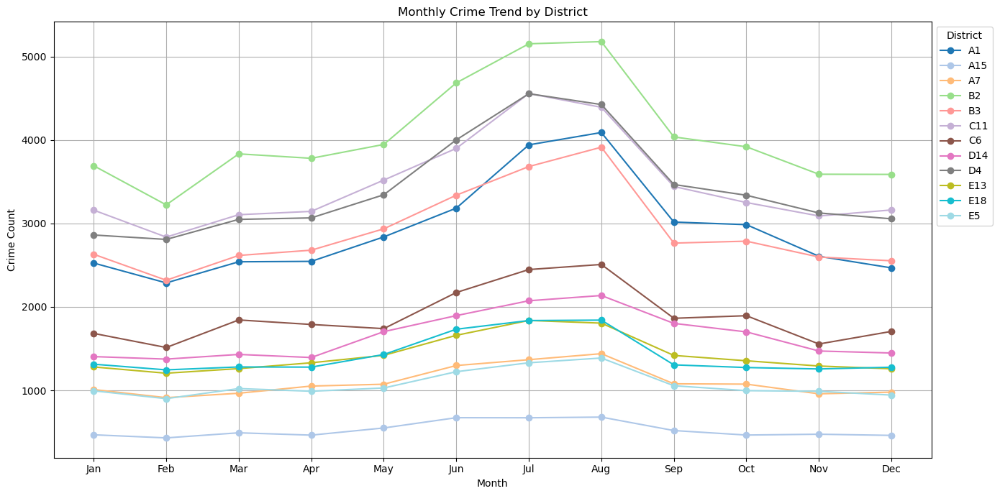

In [422]:
#21. dist_month_trend
plt.figure(figsize=(14,7))
monthly_district_crime=dist_month_trend
districts = monthly_district_crime.columns
colors = cm.tab20(np.linspace(0, 1, len(districts)))   

for dist, color in zip(districts, colors):
    plt.plot(
        monthly_district_crime.index,
        monthly_district_crime[dist],
        marker="o",
        color=color,
        label=dist
    )

plt.xlabel("Month")
plt.ylabel("Crime Count")
plt.title("Monthly Crime Trend by District")

plt.xticks(
    monthly_district_crime.index,
    ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
)

plt.legend(title="District", bbox_to_anchor=(1,1))
plt.grid(True)
plt.tight_layout()
plt.show()

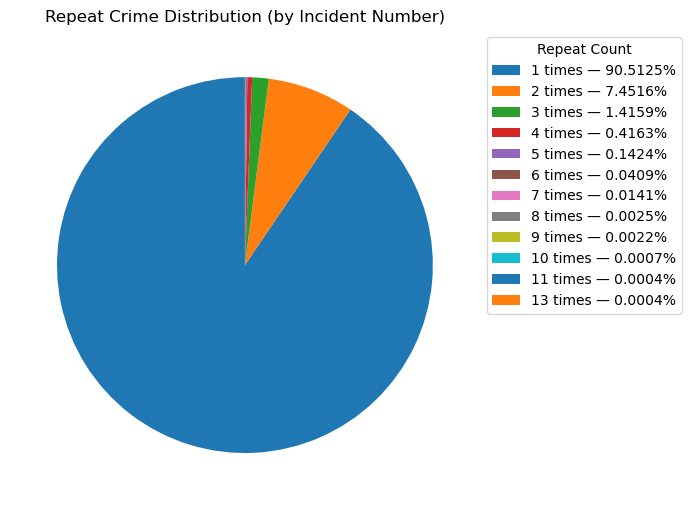

In [423]:
# 22. pi charts
sizes = repeat_distribution.values
labels = repeat_distribution.index.astype(str)

percentages = sizes / sizes.sum() * 100
legend_labels = [f"{l} times — {p:.4f}%" for l, p in zip(labels, percentages)]

plt.figure(figsize=(7,7))

plt.pie(
    sizes,
    startangle=90
)

plt.legend(
    legend_labels,
    title="Repeat Count",
    bbox_to_anchor=(1,1)
)

plt.title("Repeat Crime Distribution (by Incident Number)")
plt.tight_layout()
plt.show()


In [424]:
crime_together_count=crime_together_count.head(20)


In [425]:
crime_together_count

,Crime_Together,Together_Count
0,"(Missing Person Located, Missing Person Reported)",2702
1,"(Larceny, Motor Vehicle Accident Response)",1685
2,"(Larceny From Motor Vehicle, Vandalism)",1573
3,"(Drug Violation, Warrant Arrests)",1384
4,"(Larceny, Vandalism)",1306
5,"(Other, Simple Assault)",1303
6,"(Larceny, Other)",1280
7,"(Motor Vehicle Accident Response, Vandalism)",1217
8,"(Larceny, Property Lost)",1176
9,"(Larceny, Simple Assault)",1151


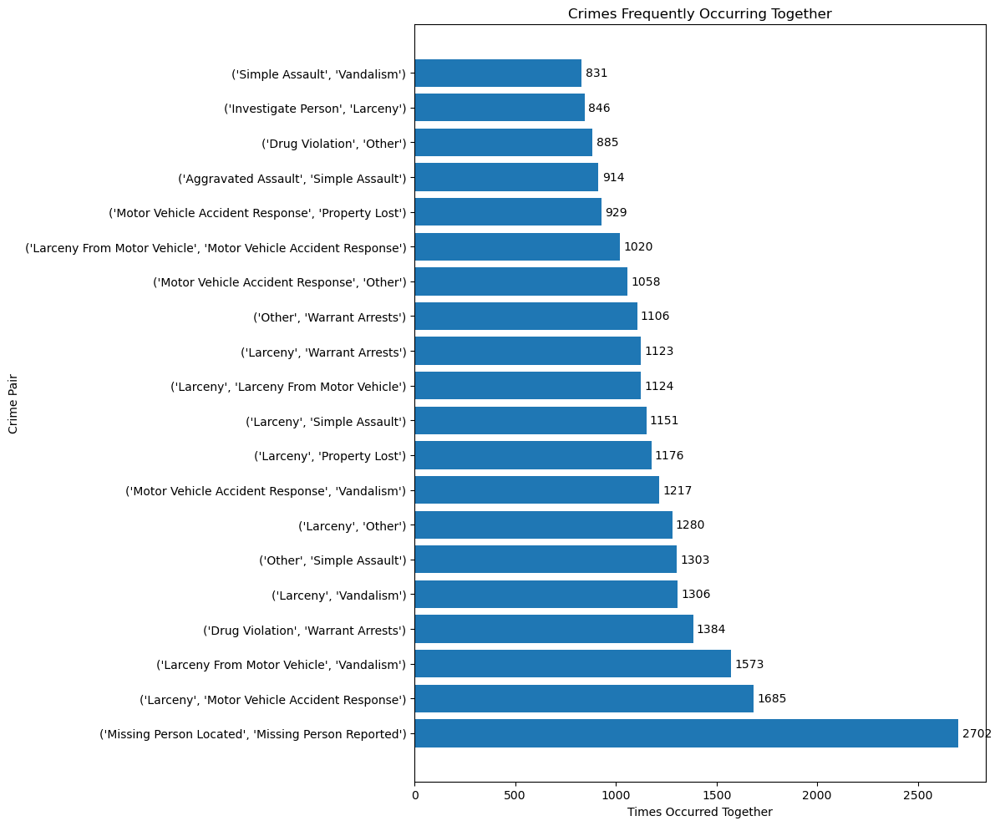

In [426]:

plt.figure(figsize=(12,10))

bars = plt.barh(
    crime_together_count["Crime_Together"].astype(str),
    crime_together_count["Together_Count"]
)
plt.bar_label(bars, fmt="%d", padding=3)
plt.xlabel("Times Occurred Together")
plt.ylabel("Crime Pair")
plt.title("Crimes Frequently Occurring Together")

plt.tight_layout()
plt.show()


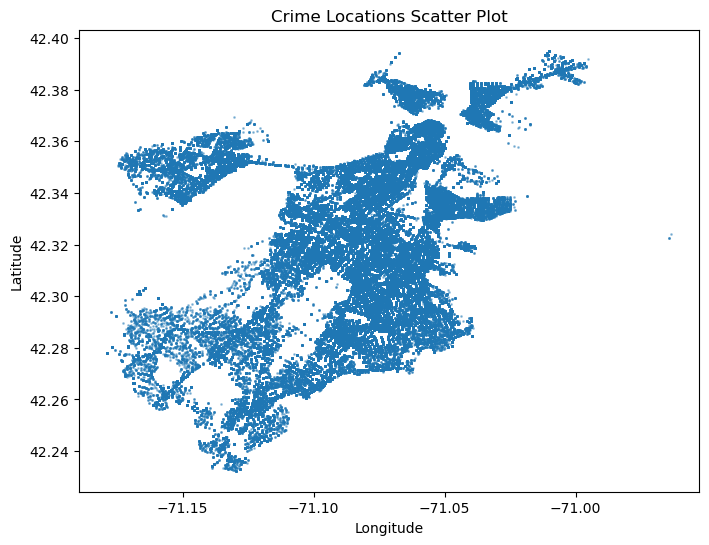

In [5]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8,6))
plt.scatter(df["Long"], df["Lat"], s=1, alpha=0.4)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Crime Locations Scatter Plot")
plt.show()


In [10]:
import plotly.express as px

fig = px.density_mapbox(
    df,
    lat="Lat",
    lon="Long",
    radius=6,
    zoom=10,
    mapbox_style="open-street-map"
)

fig.show()


ModuleNotFoundError: No module named 'geopandas'